In [2]:
import numpy as np
# from rtc_seq_dataset import SeqDistDataset, open_rtc_table
from torch.utils.data import DataLoader
from tqdm import tqdm
import torch
import pandas as pd
import geopandas as gpd
import importlib

# Data Stuff

In [2]:
df_burst_all_url = pd.read_parquet('validation_bursts_all_new100_v3_filtered.parquet')
# df_burst = gpd.read_parquet('validation_bursts_v1_coverage_updated.parquet')

df_burst = df_burst_all_url.drop_duplicates(subset='jpl_burst_id').reset_index(drop=True)
df_burst.shape

(178, 5)

/mnt/aurora-r0/jungkyo/tool/miniforge3/envs/dist-s1-3/lib/python3.12/site-packages/osgeo/gdal.py:312: FutureWarning: Neither gdal.UseExceptions() nor gdal.DontUseExceptions() has been explicitly called. In GDAL 4.0, exceptions will be enabled by default.
  warnings.warn(


0.0063095735


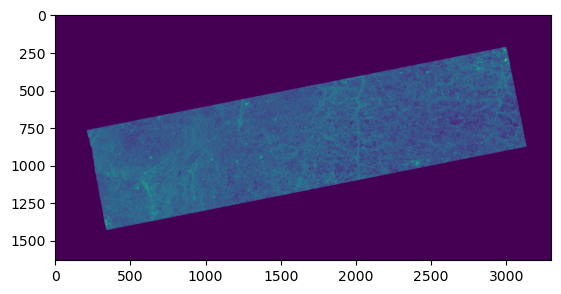

In [3]:
from osgeo import gdal
import matplotlib.pyplot as plt
gdalobj = gdal.Open('/mnt/aurora-r0/jungkyo/OPERA/DIST-S1/algorithms/dist-s1-model/test_data3/T001-000057-IW1/OPERA_L2_RTC-S1_T001-000057-IW1_20220719T180321Z_20250107T193220Z_S1A_30_v1.0_stack.tif')
data = gdalobj.ReadAsArray()

plt.imshow(data[0, :, :])
print(data[0, 0, 0])

In [4]:
import numpy as np
import pandas as pd

df  = df_burst_all_url.copy()          # start from *full* table
ids = df['jpl_burst_id'].unique()

rng       = np.random.default_rng(seed=42)   # reproducible
n_to_keep = len(ids) # // 3                    # pick half
keep_ids  = rng.choice(ids, size=n_to_keep, replace=False)

df_half = df[df['jpl_burst_id'].isin(keep_ids)].reset_index(drop=True)

In [5]:
df_burst_all_url[df_burst_all_url.jpl_burst_id == 'T056-119027-IW2']
# OPERA_L2_RTC-S1_T056-119027-IW2_20240501T131240Z_20240501T192417Z_S1A_30_v1.0_VV.tif'

,jpl_burst_id,rtc_s1_vv_url,rtc_s1_vh_url,acq_datetime,geometry
13788,T056-119027-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-05-20T13:12:35Z,"{'coordinates': [[[-107.65514 31.10314], [-1..."
13789,T056-119027-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-05-08T13:12:35Z,"{'coordinates': [[[-107.65577 31.10351], [-1..."
13790,T056-119027-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-04-26T13:12:36Z,"{'coordinates': [[[-107.65756 31.10303], [-1..."
13791,T056-119027-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-04-14T13:12:35Z,"{'coordinates': [[[-107.65459 31.1025 ], [-1..."
13792,T056-119027-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-04-02T13:12:35Z,"{'coordinates': [[[-107.65551 31.10271], [-1..."
...,...,...,...,...,...
13889,T056-119027-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2022-03-01T13:12:30Z,"{'coordinates': [[[-107.6538 31.10308], [-1..."
13890,T056-119027-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2022-02-17T13:12:30Z,"{'coordinates': [[[-107.6539 31.10329], [-1..."
13891,T056-119027-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2022-02-05T13:12:31Z,"{'coordinates': [[[-107.65294 31.10295], [-1..."
13892,T056-119027-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2022-01-24T13:12:31Z,"{'coordinates': [[[-107.65274 31.10298], [-1..."


In [6]:
df_burst_all_url = df_half

In [7]:
df_burst = df_burst_all_url.drop_duplicates(subset='acq_datetime').reset_index(drop=True)

df_rtc_subset = df_burst.reset_index(drop=True)

In [8]:
# df_rtc_subset.head()
for _, teststr in df_rtc_subset[df_rtc_subset.jpl_burst_id == 'T056-119027-IW2'].iterrows():
    print(teststr.acq_datetime, teststr.rtc_s1_vv_url)

2025-05-20T13:12:35Z https://datapool.asf.alaska.edu/RTC/OPERA-S1/OPERA_L2_RTC-S1_T056-119027-IW2_20250520T131231Z_20250520T173353Z_S1A_30_v1.0_VV.tif
2025-05-08T13:12:35Z https://datapool.asf.alaska.edu/RTC/OPERA-S1/OPERA_L2_RTC-S1_T056-119027-IW2_20250508T131232Z_20250508T182315Z_S1A_30_v1.0_VV.tif
2025-04-26T13:12:36Z https://datapool.asf.alaska.edu/RTC/OPERA-S1/OPERA_L2_RTC-S1_T056-119027-IW2_20250426T131232Z_20250426T172102Z_S1A_30_v1.0_VV.tif
2025-04-14T13:12:35Z https://datapool.asf.alaska.edu/RTC/OPERA-S1/OPERA_L2_RTC-S1_T056-119027-IW2_20250414T131232Z_20250414T204447Z_S1A_30_v1.0_VV.tif
2025-04-02T13:12:35Z https://datapool.asf.alaska.edu/RTC/OPERA-S1/OPERA_L2_RTC-S1_T056-119027-IW2_20250402T131232Z_20250402T173435Z_S1A_30_v1.0_VV.tif
2025-03-21T13:12:35Z https://datapool.asf.alaska.edu/RTC/OPERA-S1/OPERA_L2_RTC-S1_T056-119027-IW2_20250321T131232Z_20250321T174606Z_S1A_30_v1.0_VV.tif
2025-03-09T13:12:35Z https://datapool.asf.alaska.edu/RTC/OPERA-S1/OPERA_L2_RTC-S1_T056-119027-

In [9]:
num_pre_imgs = 10

In [10]:
mask = df_rtc_subset["rtc_s1_vv_url"].notna() & \
       df_rtc_subset["rtc_s1_vh_url"].notna()
df_clean = df_rtc_subset[mask]

df_clean.to_parquet('rtc_data_subset_100MGRS.parquet')

In [11]:
import sys, importlib
# importlib.reload(sys.modules['rtc_seq_dataset'])
from rtc_seq_dataset import SeqDistDataset, open_rtc_table, MultiYearDistDataset
# importlib.reload(sys.modules['rtc_seq_dataset'])


In [12]:
torch.multiprocessing.set_start_method("spawn", force=True)

seq_dataset = MultiYearDistDataset(n_pre_imgs=10,
                                    root='test_data3/',
                                    n_workers_for_download = 1,
                                    patch_size= 224,
                                    rtc_s1_parquet_table_path='rtc_data_subset_100MGRS.parquet', #have to update this for given burst range
                                    )

localize patch tables:   6%|▌         | 11/178 [00:00<00:01, 98.09it/s]

okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay


localize patch tables:  31%|███▏      | 56/178 [00:00<00:00, 184.71it/s]

okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay


localize patch tables:  69%|██████▉   | 123/178 [00:00<00:00, 261.98it/s]

okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay


localize patch tables: 100%|██████████| 178/178 [00:00<00:00, 250.08it/s]


okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay
okay


In [13]:
seq_dataset.df_st_sample

,jpl_burst_id,valid_posts_per_burst,patches_per_burst,total_samples_per_burst,total_samples_cumul
0,T001-000055-IW1,38,544,20672,20672
1,T001-000056-IW1,38,544,20672,41344
2,T001-000056-IW2,37,560,20720,62064
3,T001-000057-IW1,38,544,20672,82736
4,T001-000057-IW2,34,560,19040,101776
...,...,...,...,...,...
128,T088-187134-IW3,40,448,17920,2487525
129,T088-187135-IW3,40,448,17920,2505445
130,T088-187136-IW3,40,448,17920,2523365
131,T088-187137-IW3,40,448,17920,2541285


In [14]:
# 0. Basic consistency -----------------------------------------------
print(" df_st_sample rows :", len(seq_dataset.df_st_sample))
print(" dataset length    :", len(seq_dataset))          # must equal sum()

print(" sum(patches_per_burst)      :", seq_dataset.df_st_sample.patches_per_burst.sum())
print(" bursts with zero patches    :", (seq_dataset.df_st_sample.patches_per_burst == 0).sum())
print(" bursts with zero valid post :", (seq_dataset.df_st_sample.valid_posts_per_burst == 0).sum())

# 1. Inspect the very first burst -------------------------------------
first_row = seq_dataset.df_st_sample.iloc[0]
bid       = first_row.jpl_burst_id
print("\nFIRST BURST :", bid)
print(first_row)

# 2. Load its patch table and time series -----------------------------
patch_tbl = pd.read_parquet(
    seq_dataset.patch_by_burst_data_dir / f"patch_{bid}_{seq_dataset.patch_size}.parquet"
)
rtc_tbl   = pd.read_parquet(
    seq_dataset.rtc_by_burst_data_dir / f"rtc_{bid}.parquet"
).sort_values("acq_datetime").reset_index(drop=True)

print("  patch rows :", len(patch_tbl))
print("  rtc rows   :", len(rtc_tbl))
print("  valid posts:", seq_dataset.valid_posts[bid][:5], "… total", len(seq_dataset.valid_posts[bid]))


 df_st_sample rows : 133
 dataset length    : 2559205
 sum(patches_per_burst)      : 67552
 bursts with zero patches    : 0
 bursts with zero valid post : 0

FIRST BURST : T001-000055-IW1
jpl_burst_id               T001-000055-IW1
valid_posts_per_burst                   38
patches_per_burst                      544
total_samples_per_burst              20672
total_samples_cumul                  20672
Name: 0, dtype: object
  patch rows : 3158
  rtc rows   : 99


AttributeError: 'MultiYearDistDataset' object has no attribute 'valid_posts'

In [54]:
# seq_dataset.get_acq_dates(15287)

In [55]:
# ds = seq_dataset

# for i in [0,
#           seq_dataset.df_st_sample.total_samples_per_burst.iloc[0] + 5,
#           seq_dataset.df_st_sample.total_samples_cumul.iloc[1] + 40]:
#     print(i, seq_dataset.get_acq_dates(i))

In [ ]:
seq_dataset.__len__()

2559205

Test

In [ ]:
seq_dataset.df_st_sample

,jpl_burst_id,valid_posts_per_burst,patches_per_burst,total_samples_per_burst,total_samples_cumul
0,T001-000055-IW1,38,544,20672,20672
1,T001-000056-IW1,38,544,20672,41344
2,T001-000056-IW2,37,560,20720,62064
3,T001-000057-IW1,38,544,20672,82736
4,T001-000057-IW2,34,560,19040,101776
...,...,...,...,...,...
128,T088-187134-IW3,40,448,17920,2487525
129,T088-187135-IW3,40,448,17920,2505445
130,T088-187136-IW3,40,448,17920,2523365
131,T088-187137-IW3,40,448,17920,2541285


In [15]:
seq_dataset.df_rtc_meta

,jpl_burst_id,rtc_s1_vv_url,rtc_s1_vh_url,acq_datetime,geometry,rtc_s1_stack_loc_path
0,T001-000055-IW1,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-05-16T18:03:17Z,"{'coordinates': [[[1.5084 9.7685], [2.2771 9....",test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T00...
1,T001-000055-IW1,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-05-04T18:03:17Z,"{'coordinates': [[[1.50767 9.76872], [2.27641 ...",test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T00...
2,T001-000055-IW1,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-04-22T18:03:17Z,"{'coordinates': [[[1.50831 9.76901], [2.27697 ...",test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T00...
3,T001-000055-IW1,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-04-10T18:03:17Z,"{'coordinates': [[[1.50791 9.76869], [2.27669 ...",test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T00...
4,T001-000055-IW1,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2025-03-29T18:03:17Z,"{'coordinates': [[[1.50569 9.76872], [2.27482 ...",test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T00...
...,...,...,...,...,...,...
13342,T090-191949-IW3,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2022-09-11T21:05:00Z,"{'coordinates': [[[136.10489 49.00733], [135....",test_data3/T090-191949-IW3/OPERA_L2_RTC-S1_T09...
13343,T090-191950-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2022-09-11T21:05:02Z,"{'coordinates': [[[137.25537 48.7636 ], [136....",test_data3/T090-191950-IW2/OPERA_L2_RTC-S1_T09...
13344,T090-191950-IW3,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2022-09-11T21:05:03Z,"{'coordinates': [[[136.06285 48.84221], [134....",test_data3/T090-191950-IW3/OPERA_L2_RTC-S1_T09...
13345,T090-191951-IW2,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,https://datapool.asf.alaska.edu/RTC/OPERA-S1/O...,2022-09-11T21:05:04Z,"{'coordinates': [[[137.21141 48.59841], [135....",test_data3/T090-191951-IW2/OPERA_L2_RTC-S1_T09...


1208327
['test_data3/T044-092598-IW3/OPERA_L2_RTC-S1_T044-092598-IW3_20221213T165738Z_20250301T134409Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092598-IW3/OPERA_L2_RTC-S1_T044-092598-IW3_20221225T165738Z_20250302T034015Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092598-IW3/OPERA_L2_RTC-S1_T044-092598-IW3_20230106T165737Z_20250118T190628Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092598-IW3/OPERA_L2_RTC-S1_T044-092598-IW3_20230118T165736Z_20250120T013931Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092598-IW3/OPERA_L2_RTC-S1_T044-092598-IW3_20231220T165742Z_20231222T140855Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092598-IW3/OPERA_L2_RTC-S1_T044-092598-IW3_20240101T165742Z_20240101T230836Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092598-IW3/OPERA_L2_RTC-S1_T044-092598-IW3_20240113T165742Z_20240113T233046Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092598-IW3/OPERA_L2_RTC-S1_T044-092598-IW3_20241214T165739Z_20241214T190522Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092598-IW3/OPERA_L2_RTC-S1_T04

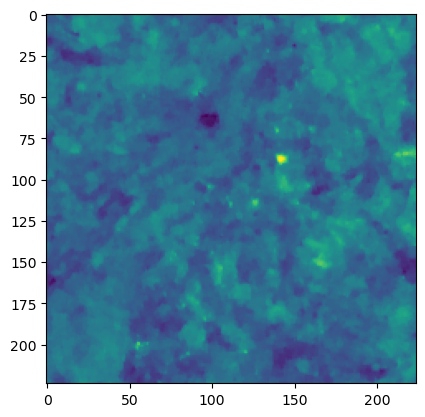

In [16]:
import matplotlib.pyplot as plt
index = np.random.randint(len(seq_dataset))
print(index)

plt.imshow(np.log(seq_dataset[index]["post_img"][0,:,:]))
# plt.imshow(seq_dataset[index]["post_img"][1,:,:])
print(seq_dataset[index]["post_img"][0, 0, 0])

Dataset length : 2559205
['test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T001-000055-IW1_20220108T180311Z_20241218T055125Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T001-000055-IW1_20220120T180310Z_20241220T073427Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T001-000055-IW1_20220201T180309Z_20241220T222453Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T001-000055-IW1_20220213T180309Z_20241222T060709Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T001-000055-IW1_20230115T180316Z_20250119T181058Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T001-000055-IW1_20230127T180316Z_20250121T003904Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T001-000055-IW1_20230208T180315Z_20250122T070551Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000055-IW1/OPERA_L2_RTC-S1_T001-000055-IW1_20231217T180322Z_20231218T211002Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000055-IW1/OP

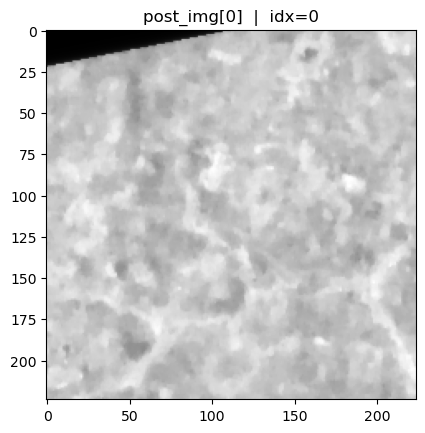

In [17]:
print("Dataset length :", len(seq_dataset))  
idx = 0                                      
sample = seq_dataset[idx]                    
print(np.shape(sample["pre_imgs"]))
plt.imshow(np.log(sample["pre_imgs"][9][0, :, :].numpy()), cmap="gray")
plt.title(f"post_img[0]  |  idx={idx}")
plt.show()

In [18]:
len(seq_dataset)

2559205

In [19]:
dataloader = DataLoader(seq_dataset, batch_size=32, shuffle=True)
print(len(dataloader))

79976


### Various storage experiments

In [20]:
for i, data in enumerate(dataloader):
    train_data = data["pre_imgs"]
    target = data["post_img"]
    print(train_data.shape)
    print(target.shape)
    break

['test_data3/T066-140422-IW1/OPERA_L2_RTC-S1_T066-140422-IW1_20220829T053608Z_20250217T070551Z_S1A_30_v1.0_stack.tif', 'test_data3/T066-140422-IW1/OPERA_L2_RTC-S1_T066-140422-IW1_20220910T053609Z_20250218T022341Z_S1A_30_v1.0_stack.tif', 'test_data3/T066-140422-IW1/OPERA_L2_RTC-S1_T066-140422-IW1_20220922T053608Z_20250219T002311Z_S1A_30_v1.0_stack.tif', 'test_data3/T066-140422-IW1/OPERA_L2_RTC-S1_T066-140422-IW1_20221004T053610Z_20250220T010104Z_S1A_30_v1.0_stack.tif', 'test_data3/T066-140422-IW1/OPERA_L2_RTC-S1_T066-140422-IW1_20230905T053614Z_20250213T093927Z_S1A_30_v1.0_stack.tif', 'test_data3/T066-140422-IW1/OPERA_L2_RTC-S1_T066-140422-IW1_20230917T053614Z_20250214T074931Z_S1A_30_v1.0_stack.tif', 'test_data3/T066-140422-IW1/OPERA_L2_RTC-S1_T066-140422-IW1_20230929T053615Z_20250215T051925Z_S1A_30_v1.0_stack.tif', 'test_data3/T066-140422-IW1/OPERA_L2_RTC-S1_T066-140422-IW1_20240830T053610Z_20240830T163612Z_S1A_30_v1.0_stack.tif', 'test_data3/T066-140422-IW1/OPERA_L2_RTC-S1_T066-140422

In [21]:
dataset_of_128 = torch.utils.data.TensorDataset(train_data, target)

In [22]:
import os
os.makedirs('PytorchData', exist_ok=True)
torch.save(dataset_of_128, "PytorchData/how_much_space_is_this_128.pt")

In [23]:

hmm = torch.load("PytorchData/how_much_space_is_this_128.pt")

# Transformer

In [2]:
import numpy as np
from torch.utils.data import DataLoader, random_split, RandomSampler, SequentialSampler
import matplotlib.pyplot as plt
import torch
from tqdm import tqdm
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import DataLoader, Subset, ConcatDataset
import time
import random
from IPython.display import HTML
from utils import log_ratio, visualize_reconstruction, animate_data, nll_gaussian, nll_gaussian_stable
import einops


### New stuff

In [23]:

class SpatioTemporalTransformer(nn.Module):
    def __init__(self, model_config: dict) -> None:
        super().__init__()

        self.d_model = model_config['d_model']
        self.nhead = model_config['nhead']
        self.num_encoder_layers = model_config['num_encoder_layers']
        self.dim_feedforward = model_config['dim_feedforward']
        self.max_seq_len = model_config['max_seq_len']
        self.dropout = model_config['dropout']
        self.activation = model_config['activation']

        self.num_patches = model_config['num_patches']
        self.patch_size = model_config['patch_size']
        self.data_dim = model_config['data_dim']

        self.embedding = nn.Linear(self.data_dim, self.d_model)

        self.spatial_pos_embed = nn.Parameter(torch.zeros(1, 1, self.num_patches, self.d_model))
        self.temporal_pos_embed = nn.Parameter(torch.zeros(1, self.max_seq_len, 1, self.d_model))

        encoder_layer = nn.TransformerEncoderLayer(
            self.d_model,
            self.nhead,
            self.dim_feedforward,
            dropout=self.dropout,
            activation=self.activation,
            batch_first=True,
        )

        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, self.num_encoder_layers)

        self.mean_out = nn.Sequential(
            nn.Linear(self.d_model, self.dim_feedforward),  # reuse dim feedforward here
            nn.ReLU(),
            nn.Linear(self.dim_feedforward, self.data_dim),
        )

        self.logvar_out = nn.Sequential(
            nn.Linear(self.d_model, self.dim_feedforward),  # reuse dim feedforward here
            nn.ReLU(),
            nn.Linear(self.dim_feedforward, self.data_dim),
        )

    def num_parameters(self) -> float:
        """Count the number of trainable parameters in the model."""
        if not hasattr(self, '_num_parameters'):
            self._num_parameters = 0
            for p in self.parameters():
                count = 1
                for s in p.size():
                    count *= s
                self._num_parameters += count

        return self._num_parameters

    def forward(self, img_baseline: torch.Tensor) -> tuple[torch.Tensor, torch.Tensor]:
        batch_size, seq_len, channels, height, width = img_baseline.shape

        assert self.num_patches == (height * width) / (self.patch_size**2)

        img_baseline = einops.rearrange(
            img_baseline, 'b t c (h ph) (w pw) -> b t (h w) (c ph pw)', ph=self.patch_size, pw=self.patch_size
        )  # batch, seq_len, num_patches, data_dim

        img_baseline = (
            self.embedding(img_baseline)
            + self.spatial_pos_embed
            # changed self.temporal_pos_embed[:, :seq_len, :, :]
            # to self.temporal_pos_embed[:, (self.max_seq_len-seq_len):, :, :] to ensure last pre-image always has
            # correct index
            + self.temporal_pos_embed[:, (self.max_seq_len - seq_len) :, :, :]
        )  # batch, seq_len, num_patches, d_model

        img_baseline = img_baseline.view(
            batch_size, seq_len * self.num_patches, self.d_model
        )  # transformer expects (batch_size, sequence, dmodel)

        output = self.transformer_encoder(img_baseline)

        mean = self.mean_out(output)  # batchsize, seq_len*num_patches, data_dim
        logvar = self.logvar_out(output)  # batchsize, seq_len*num_patches, 2*data_dim

        mean = mean.view(batch_size, seq_len, self.num_patches, self.data_dim)  # undo previous operation
        logvar = logvar.view(batch_size, seq_len, self.num_patches, self.data_dim)

        # reshape to be the same shape as input batch_size, seq len, channels, height, width
        mean = einops.rearrange(
            mean,
            'b t (h w) (c ph pw) -> b t c (h ph) (w pw)',
            ph=self.patch_size,
            pw=self.patch_size,
            c=channels,
            h=height // self.patch_size,
            w=width // self.patch_size,
        )

        # reshape so for each pixel we output 4 numbers (ie each entry of cov matrix)
        logvar = einops.rearrange(
            logvar,
            'b t (h w) (c ph pw) -> b t c (h ph) (w pw)',
            ph=self.patch_size,
            pw=self.patch_size,
            c=channels,
            h=height // self.patch_size,
            w=width // self.patch_size,
        )

        return mean[:, -1, ...], logvar[:, -1, ...]


def get_device() -> str:
    if torch.cuda.is_available():
        device = 'cuda'
    elif platform.system() == 'Darwin' and torch.backends.mps.is_available():
        device = 'mps'
    else:
        device = 'cpu'
    return device

In [24]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


In [6]:
import time

# this line is slow for some reason and we need it every loss so we construct it once to start
pi = torch.FloatTensor([np.pi]).to(device)

def run_epoch(dataloader, model, optimizer, device, train=True):
    """Perform one epoch of training by looping through the dataset once."""

    '''
    dataloader should have:
    pre_imgs: (batch_size, max_seq_len, channels, height, width)
    target: (batch_size, channels, height, width)
    '''

    # Setting models and datasets into train/test mode
    if train:
        model.train()
    else:
        model.eval()

    nll_total = 0
    mse_total = 0

    naive_nll = 0
    naive_mse = 0

    for batch_idx, (batch,target) in enumerate(dataloader):

        input_size = 16
        
        batch = batch.unfold(3, input_size, input_size).unfold(4, input_size, input_size)
        target = target.unfold(2, input_size, input_size).unfold(3, input_size, input_size)

        batch = batch.permute(0, 3, 4, 1, 2, 5, 6).reshape(-1, 10, 2, input_size, input_size)
        target = target.permute(0, 2, 3, 1, 4, 5).reshape(-1, 2, input_size, input_size)

        target = torch.special.logit(target) #make sure you're doing this once and not 0 or 2 times...
        batch = torch.special.logit(batch)

        ### 
        # mask_out_idx = torch.randint(0,9,(1,))
        # batch = batch[:, mask_out_idx:, ...] 
        ###
        
        target = target.to(device) #might have to change this depending on dataloading approach
        batch = batch.to(device)

        if train:
          
          pred_means, pred_logvars = model(batch)
          
          # dataset was originally set up to take pre_imgs and predict target, now we train autoregressively so every part of
          # the sequence is the target
          actual_target = torch.cat((batch[:,1:,...],target.unsqueeze(dim=1)), 1)

          # new style
          # need to input pi as constructed above because for some reason constructing it each time was slow
          loss = nll_gaussian(pred_means, pred_logvars, actual_target, pi) 
          mse_total += F.mse_loss(pred_means, actual_target).item()

          optimizer.zero_grad()
          loss.backward()
          torch.nn.utils.clip_grad_norm_(model.parameters(), 10) 
          optimizer.step()

        else:
          with torch.no_grad():

            # compute baseline based on pre image mean and var
            pre_image_mean = torch.mean(batch, dim=1)
            pre_image_var = torch.var(batch, dim=1)
            pre_image_var += 1e-8 # for numerical stability

            naive_nll += nll_gaussian_stable(pre_image_mean, pre_image_var, target)
            naive_mse += F.mse_loss(pre_image_mean, target).item()

            # get prediction
            pred_means, pred_logvars = model(batch)

            actual_target = torch.cat((batch[:,1:,...],target.unsqueeze(dim=1)), 1)
            loss = nll_gaussian(pred_means, pred_logvars, actual_target, pi)
              
            mse_total += F.mse_loss(pred_means, actual_target).item()

        nll_total += loss.item()

    nll_average = nll_total / len(dataloader) # average NLL per sequence (sample)
    mse_average = mse_total / len(dataloader)

    naive_nll_average = naive_nll / len(dataloader)
    naive_mse_average = naive_mse / len(dataloader)

    if epoch % 10 == 0:
      print('Train \n' if train else 'Test \n')
      print('NLL: {:.6f}'.format(nll_average))
      if not train:
        print('Naive NLL: {:.6f}\n'.format(naive_nll_average))

      print('MSE: {:.6f}'.format(mse_average))
      if not train:
        print('Naive MSE: {:.6f}'.format(naive_mse_average))
      print(" ")

    return nll_average, mse_average 

### end of summer code

In [3]:
class SpatioTemporalTransformer(nn.Module):
    def __init__(self, model_config):
        super(SpatioTemporalTransformer, self).__init__()

        # self.data_dim = model_config['data_dim'] # dim of patches
        self.d_model = model_config['d_model']
        self.nhead = model_config['nhead']
        self.num_encoder_layers = model_config['num_encoder_layers']
        self.dim_feedforward = model_config['dim_feedforward']
        self.max_seq_len = model_config['max_seq_len']
        self.dropout = model_config['dropout']
        self.activation = model_config['activation']

        self.num_patches = model_config['num_patches']
        self.patch_size = model_config['patch_size']
        self.data_dim = model_config['data_dim']

        self.embedding = nn.Linear(self.data_dim, self.d_model)

        self.spatial_pos_embed = nn.Parameter(torch.zeros(1, 1, self.num_patches, self.d_model))
        self.temporal_pos_embed = nn.Parameter(torch.zeros(1, self.max_seq_len, 1, self.d_model))

        #we use 'encoder' for simplicity - but equivalent to the "Decoder only" framework
        encoder_layer = nn.TransformerEncoderLayer(
            self.d_model, self.nhead, self.dim_feedforward, dropout=self.dropout, activation=self.activation, batch_first=True
            )

        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, self.num_encoder_layers)

        self.mean_out = nn.Sequential(
            nn.Linear(self.d_model, self.dim_feedforward), #reuse dim feedforward here
            nn.ReLU(),
            nn.Linear(self.dim_feedforward, self.data_dim)
        )

        self.logvar_out = nn.Sequential(
            nn.Linear(self.d_model, self.dim_feedforward), #reuse dim feedforward here
            nn.ReLU(),
            nn.Linear(self.dim_feedforward, self.data_dim)
        )

    def num_parameters(self):
        """Count the number of trainable parameters in the model."""
        if not hasattr(self, '_num_parameters'):
            self._num_parameters = 0
            for p in self.parameters():
                count = 1
                for s in p.size():
                    count *= s
                self._num_parameters += count

        return self._num_parameters

    def forward(self, src):

        batch_size, seq_len, channels, height, width = src.shape

        assert num_patches == (height*width) / (self.patch_size**2)

        src = einops.rearrange(src, 'b t c (h ph) (w pw) -> b t (h w) (c ph pw)', ph=self.patch_size, pw=self.patch_size) # batch, seq_len, num_patches, data_dim

        src = self.embedding(src) + self.spatial_pos_embed + self.temporal_pos_embed[:, (self.max_seq_len-seq_len):, :, :] # batch, seq_len, num_patches, d_model

        src = src.view(batch_size, seq_len * self.num_patches, self.d_model) # transformer expects (batch_size, sequence, dmodel)

        # Pass through the transformer encoder with causal masking
        # mask = nn.Transformer.generate_square_subsequent_mask(seq_len).to(src.device)
        # mask = mask.repeat(self.num_patches, self.num_patches)

        output = self.transformer_encoder(src) #, mask=mask, is_causal=True) # is_causal makes this masked attention

        mean = self.mean_out(output) # batchsize, seq_len*num_patches, data_dim
        logvar = self.logvar_out(output) # batchsize, seq_len*num_patches, 2*data_dim

        mean = mean.view(batch_size, seq_len, self.num_patches, self.data_dim) #undo previous operation
        logvar = logvar.view(batch_size, seq_len, self.num_patches, self.data_dim)

        # reshape to be the same shape as input batch_size, seq len, channels, height, width
        mean = einops.rearrange(mean, 'b t (h w) (c ph pw) -> b t c (h ph) (w pw)',
                                ph=self.patch_size, pw=self.patch_size,c=channels, h=height//patch_size, w=width//patch_size)

        # reshape so for each pixel we output 4 numbers (ie each entry of cov matrix)
        logvar = einops.rearrange(logvar, 'b t (h w) (c ph pw) -> b t c (h ph) (w pw)',
                                ph=self.patch_size, pw=self.patch_size,c=channels, h=height//patch_size, w=width//patch_size)

        # logvar = einops.rearrange(logvar, 'b t (h w) (c ph pw) -> b t (h ph) (w pw) c',
        #                         ph=self.patch_size, pw=self.patch_size, h=height//patch_size, w=width//patch_size, c=3)

        # sigma1 = F.softplus(logvar[:,:,:,:,0])
        # sigma2 = F.softplus(logvar[:,:,:,:,1])
        # corr = F.tanh(logvar[:,:,:,:,2])

        return mean[:,-1,...], logvar[:,-1,...] # output just the last one

device = 'cuda'
pi = torch.FloatTensor([np.pi]).to(device)

def run_epoch_tf(dataloader, model, optimizer, device, train=True):
    """Perform one epoch of training by looping through the dataset once."""

    '''
    dataloader should have:
    pre_imgs: (batch_size, max_seq_len, channels, height, width)
    target: (batch_size, channels, height, width)
    '''

    # Setting models and datasets into train/test mode
    if train:
        model.train()
    else:
        model.eval()

    nll_total = 0
    mse_total = 0

    naive_nll = 0
    naive_mse = 0

    for batch_idx, (batch, target) in enumerate(dataloader):

        input_size = 16
        
        batch = batch.unfold(3, input_size, input_size).unfold(4, input_size, input_size)
        target = target.unfold(2, input_size, input_size).unfold(3, input_size, input_size)

        batch = batch.permute(0, 3, 4, 1, 2, 5, 6).reshape(-1, 10, 2, input_size, input_size)
        target = target.permute(0, 2, 3, 1, 4, 5).reshape(-1, 2, input_size, input_size)

        target = torch.special.logit(target) #make sure you're doing this once and not 0 or 2 times...
        batch = torch.special.logit(batch)

        ###

        mask_out_idx = torch.randint(0,9,(1,)) #vary the time window the model sees

        # target = target.flatten(start_dim=1)
        target = target.to(device)

        batch = batch[:, mask_out_idx:, ...] # "batch" is the pre images
        # batch = batch.flatten(start_dim = 2)
        batch = batch.to(device)

        if train:

          pred_means, pred_logvars = model(batch)

          # new style
          loss = nll_gaussian(pred_means, pred_logvars, target) #, pi=pi)
          mse_total += F.mse_loss(pred_means, target).item()

          # both
          # loss = nll_gaussian(pred_means[:,:-1,:], pred_logvars[:,:-1,:], batch)
          # mse_total += F.mse_loss(pred_means[:,:-1,:], batch).item()
          # loss += nll_gaussian(pred_means[:,-1,:], pred_logvars[:,-1,:], target)
          # mse_total += F.mse_loss(pred_means[:,-1,:], target).item()

          # og
          # loss = nll_gaussian(pred_means, pred_logvars, batch)
          # mse_total += F.mse_loss(pred_means, batch).item()

          optimizer.zero_grad()
          loss.backward()
          torch.nn.utils.clip_grad_norm_(model.parameters(), 10) # likely not necessary for transformer
          optimizer.step()

        else:
          with torch.no_grad():

            # compute baseline based on pre image mean and var
            pre_image_mean = torch.mean(batch, dim=1)
            pre_image_var = torch.var(batch, dim=1)
            pre_image_var += 1e-8 # for numerical stability

            naive_nll += nll_gaussian_stable(pre_image_mean, pre_image_var, target)
            naive_mse += F.mse_loss(pre_image_mean, target).item()

            # get prediction
            pred_means, pred_logvars = model(batch)

            loss = nll_gaussian(pred_means, pred_logvars, target) #, pi=pi)
            mse_total += F.mse_loss(pred_means, target).item()

        nll_total += loss.item()

    nll_average = nll_total / len(dataloader) # average NLL per sequence (sample)
    mse_average = mse_total / len(dataloader)

    naive_nll_average = naive_nll / len(dataloader)
    naive_mse_average = naive_mse / len(dataloader)

    if epoch % 10 == 0:
      print('Train \n' if train else 'Test \n')
      print('NLL: {:.6f}'.format(nll_average))
      if not train:
        print('Naive NLL: {:.6f}\n'.format(naive_nll_average))

      print('MSE: {:.6f}'.format(mse_average))
      if not train:
        print('Naive MSE: {:.6f}'.format(naive_mse_average))
      print(" ")

    return nll_average, mse_average #had nll average first

## Train

### Data

In [26]:
gen = torch.Generator().manual_seed(42)
# torch.cuda.manual_seed_all(SEED)
# torch.backends.cudnn.benchmark = False
# torch.backends.cudnn.deterministic = True
train_dataset, test_dataset, _ = random_split(seq_dataset, [.01, .0025, .9875], generator=gen)

In [27]:
seq_dataset.df_st_sample

,jpl_burst_id,valid_posts_per_burst,patches_per_burst,total_samples_per_burst,total_samples_cumul
0,T001-000055-IW1,38,544,20672,20672
1,T001-000056-IW1,38,544,20672,41344
2,T001-000056-IW2,37,560,20720,62064
3,T001-000057-IW1,38,544,20672,82736
4,T001-000057-IW2,34,560,19040,101776
...,...,...,...,...,...
128,T088-187134-IW3,40,448,17920,2487525
129,T088-187135-IW3,40,448,17920,2505445
130,T088-187136-IW3,40,448,17920,2523365
131,T088-187137-IW3,40,448,17920,2541285


In [28]:
print(len(train_dataset))
print(len(test_dataset))

25593
6398


In [47]:
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
print(len(train_loader))
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=True)
print(len(test_loader))

800
200


In [30]:
print(len(train_dataset))
import time, torch
t0 = time.time()
sample = train_dataset[0]
print("getitem:", time.time() - t0, "s")

# 2️⃣ Fetch first batch without workers
loader_seq = DataLoader(train_dataset, batch_size=BATCH_SIZE, num_workers=0)
t0 = time.time()
batch = next(iter(loader_seq))
print("single-proc batch:", time.time() - t0, "s")


def test_script(loader, name):
    shard_id = 0
    x_buf, y_buf = [], []
    # for batch in tqdm(loader, desc=f"Saving {name}", ncols=100):

    for batch_ind, batch in enumerate(loader):
        print(batch_ind)

test_script(loader_seq, 'aa')

25593
['test_data3/T051-108229-IW2/OPERA_L2_RTC-S1_T051-108229-IW2_20220828T045612Z_20250217T053118Z_S1A_30_v1.0_stack.tif', 'test_data3/T051-108229-IW2/OPERA_L2_RTC-S1_T051-108229-IW2_20220921T045612Z_20250218T214932Z_S1A_30_v1.0_stack.tif', 'test_data3/T051-108229-IW2/OPERA_L2_RTC-S1_T051-108229-IW2_20221003T045613Z_20250219T232025Z_S1A_30_v1.0_stack.tif', 'test_data3/T051-108229-IW2/OPERA_L2_RTC-S1_T051-108229-IW2_20221015T045613Z_20250220T210646Z_S1A_30_v1.0_stack.tif', 'test_data3/T051-108229-IW2/OPERA_L2_RTC-S1_T051-108229-IW2_20230904T045618Z_20250213T075744Z_S1A_30_v1.0_stack.tif', 'test_data3/T051-108229-IW2/OPERA_L2_RTC-S1_T051-108229-IW2_20230916T045618Z_20250214T055941Z_S1A_30_v1.0_stack.tif', 'test_data3/T051-108229-IW2/OPERA_L2_RTC-S1_T051-108229-IW2_20230928T045618Z_20250215T033929Z_S1A_30_v1.0_stack.tif', 'test_data3/T051-108229-IW2/OPERA_L2_RTC-S1_T051-108229-IW2_20240910T045614Z_20240910T073718Z_S1A_30_v1.0_stack.tif', 'test_data3/T051-108229-IW2/OPERA_L2_RTC-S1_T051-

NameError: name 'BATCH_SIZE' is not defined

In [31]:
import torch, time
from torch.utils.data import DataLoader
BATCH_SIZE          = 32

def first_batch_ok(loader, label):
    t0 = time.time()
    try:
        next(iter(loader))
        print(f"{label}: fetched in {time.time()-t0:.2f}s")
    except Exception as e:
        print(f"{label}: FAILED →", e)

for ctx in ("fork", "spawn"):
    torch.multiprocessing.set_start_method(ctx, force=True)
    loader = DataLoader(train_dataset,
                        batch_size=BATCH_SIZE,
                        num_workers=4,
                        pin_memory=False,
                        persistent_workers=False,
                        multiprocessing_context=ctx,
                        timeout=30)
    first_batch_ok(loader, ctx)


['test_data3/T006-011718-IW1/OPERA_L2_RTC-S1_T006-011718-IW1_20220825T025928Z_20250217T004003Z_S1A_30_v1.0_stack.tif', 'test_data3/T006-011718-IW1/OPERA_L2_RTC-S1_T006-011718-IW1_20220906T025929Z_20250217T195639Z_S1A_30_v1.0_stack.tif', 'test_data3/T006-011718-IW1/OPERA_L2_RTC-S1_T006-011718-IW1_20220918T025928Z_20250218T162332Z_S1A_30_v1.0_stack.tif', 'test_data3/T006-011718-IW1/OPERA_L2_RTC-S1_T006-011718-IW1_20220930T025929Z_20250219T134551Z_S1A_30_v1.0_stack.tif', 'test_data3/T006-011718-IW1/OPERA_L2_RTC-S1_T006-011718-IW1_20230901T025933Z_20250213T022912Z_S1A_30_v1.0_stack.tif', 'test_data3/T006-011718-IW1/OPERA_L2_RTC-S1_T006-011718-IW1_20230913T025933Z_20250214T003433Z_S1A_30_v1.0_stack.tif', 'test_data3/T006-011718-IW1/OPERA_L2_RTC-S1_T006-011718-IW1_20230925T025934Z_20250214T221854Z_S1A_30_v1.0_stack.tif', 'test_data3/T006-011718-IW1/OPERA_L2_RTC-S1_T006-011718-IW1_20240826T025929Z_20240826T133820Z_S1A_30_v1.0_stack.tif', 'test_data3/T006-011718-IW1/OPERA_L2_RTC-S1_T006-011718

terminate called without an active exception


['test_data3/T073-154891-IW1/OPERA_L2_RTC-S1_T073-154891-IW1_20221028T164119Z_20250221T180230Z_S1A_30_v1.0_stack.tif', 'test_data3/T073-154891-IW1/OPERA_L2_RTC-S1_T073-154891-IW1_20221109T164119Z_20250222T153703Z_S1A_30_v1.0_stack.tif', 'test_data3/T073-154891-IW1/OPERA_L2_RTC-S1_T073-154891-IW1_20221121T164119Z_20250223T120536Z_S1A_30_v1.0_stack.tif', 'test_data3/T073-154891-IW1/OPERA_L2_RTC-S1_T073-154891-IW1_20221203T164118Z_20250301T024358Z_S1A_30_v1.0_stack.tif', 'test_data3/T073-154891-IW1/OPERA_L2_RTC-S1_T073-154891-IW1_20231104T164124Z_20231105T190129Z_S1A_30_v1.0_stack.tif', 'test_data3/T073-154891-IW1/OPERA_L2_RTC-S1_T073-154891-IW1_20231116T164124Z_20231117T122717Z_S1A_30_v1.0_stack.tif', 'test_data3/T073-154891-IW1/OPERA_L2_RTC-S1_T073-154891-IW1_20231128T164123Z_20231210T195115Z_S1A_30_v1.0_stack.tif', 'test_data3/T073-154891-IW1/OPERA_L2_RTC-S1_T073-154891-IW1_20241029T164121Z_20241030T014841Z_S1A_30_v1.0_stack.tif', 'test_data3/T073-154891-IW1/OPERA_L2_RTC-S1_T073-154891

terminate called without an active exception
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb182076200>
Traceback (most recent call last):
  File "/mnt/aurora-r0/jungkyo/tool/miniforge3/envs/dist-s1-3/lib/python3.12/site-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/mnt/aurora-r0/jungkyo/tool/miniforge3/envs/dist-s1-3/lib/python3.12/site-packages/torch/utils/data/dataloader.py", line 1443, in _shutdown_workers
    w.join(timeout=_utils.MP_STATUS_CHECK_INTERVAL)
  File "/mnt/aurora-r0/jungkyo/tool/miniforge3/envs/dist-s1-3/lib/python3.12/multiprocessing/process.py", line 149, in join
    res = self._popen.wait(timeout)
          ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/mnt/aurora-r0/jungkyo/tool/miniforge3/envs/dist-s1-3/lib/python3.12/multiprocessing/popen_fork.py", line 40, in wait
    if not wait([self.sentinel], timeout):
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/mnt/aurora-r0/jungkyo/tool/mini

spawn: fetched in 33.15s


In [ ]:
from pathlib import Path
from torch.utils.data import DataLoader, random_split, TensorDataset, ConcatDataset

PATCH_SIZE          = 224
BATCH_SIZE          = 32
NUM_WORKERS         = 4

PIN_MEMORY          = True          # if you plan to train on GPU later
SHARD_SIZE          = 1024          # samples per file
BATCH_SIZE  = 128
SHARD_SIZE  = 4096
CAST_TO_FP16        = False          # set False to keep fp32
SAVE_DIR            = Path("PytorchData")   # will contain shards
SAVE_DIR.mkdir(parents=True, exist_ok=True)
SAVE_DIR            = Path("PytorchData4")   # will contain shards
SAVE_DIR.mkdir(parents=True, exist_ok=True)

# def make_loader(ds, shuffle):
#     return DataLoader(ds,
#                       batch_size=BATCH_SIZE,
#                       shuffle=shuffle,
#                       num_workers=4,
#                       pin_memory=PIN_MEMORY,
#                       persistent_workers=True)

make_loader = lambda ds, shuffle: DataLoader(
    ds,
    batch_size          = 16,      # smaller buffer = faster first flush
    shuffle             = shuffle,
    num_workers         = 0,       # single-proc → no pickle, no fork issues
    pin_memory          = False,   # not training yet
    persistent_workers  = False
)

print('start making loader')
train_loader = make_loader(train_dataset , shuffle=True)
test_loader  = make_loader(test_dataset,  shuffle=False)
print('completed making loader')


# ────────────────────────────────────────────────────────────────────────────────
# 2.  Helper to flush buffer → shard file
# ────────────────────────────────────────────────────────────────────────────────
def flush_shard(x_buf, y_buf, name, shard_id):
    """Concatenate buffers, save <name>_<id>.pt, clear buffers."""
    if not x_buf:
        return
    xs = torch.cat(x_buf)
    ys = torch.cat(y_buf)
    fname = SAVE_DIR / f"{name}_{shard_id:03d}.pt"
    torch.save((xs, ys), fname)
    x_buf.clear(); y_buf.clear()


# ────────────────────────────────────────────────────────────────────────────────
# 3.  Stream each loader → shards
# ────────────────────────────────────────────────────────────────────────────────
def stream_to_shards(loader, name):
    shard_id = 0
    x_buf, y_buf = [], []
    # for batch in tqdm(loader, desc=f"Saving {name}", ncols=100):

    for batch_ind, batch in enumerate(loader):
        print(batch_ind)
        if batch_ind % 10 == 0:
            print(batch_ind, len(loader))
        x = batch["pre_imgs"]
        y = batch["post_img"]
        if CAST_TO_FP16:
            x = x.half()
            y = y.half()

        x_buf.append(x.cpu())   # keep on CPU so GPU RAM stays free
        y_buf.append(y.cpu())

        # If buffer ≥ shard_size samples → flush
        if sum(t.shape[0] for t in x_buf) >= SHARD_SIZE:
            flush_shard(x_buf, y_buf, name, shard_id)
            shard_id += 1

    # flush tail
    flush_shard(x_buf, y_buf, name, shard_id)


# stream_to_shards(train_loader, "train")
# stream_to_shards(test_loader,  "test")

print("Done! Shards written to", SAVE_DIR.resolve())


# ────────────────────────────────────────────────────────────────────────────────
# 4.  Reload later
# ────────────────────────────────────────────────────────────────────────────────
def load_sharded_dataset(prefix):
    shards = sorted(SAVE_DIR.glob(f"{prefix}_*.pt"))
    datasets = [TensorDataset(*torch.load(p, map_location="cpu")) for p in shards]
    return ConcatDataset(datasets)

start making loader
completed making loader
Done! Shards written to /mnt/aurora-r0/jungkyo/OPERA/DIST-S1/algorithms/dist-s1-model/PytorchData3


In [33]:
import os, multiprocessing as mp

# Keep every low-level library single-threaded
os.environ["OMP_NUM_THREADS"]       = "1"
os.environ["MKL_NUM_THREADS"]       = "1"
os.environ["OPENBLAS_NUM_THREADS"]  = "1"
os.environ["NUMEXPR_NUM_THREADS"]   = "1"
# …any other BLAS/OpenMP env vars your site sets…

import torch, time
from pathlib import Path
from torch.utils.data import DataLoader, TensorDataset, ConcatDataset
from concurrent.futures import ThreadPoolExecutor
from tqdm.auto import tqdm          # Jupyter-/terminal-friendly

BATCH_SIZE   = 128
SHARD_SIZE   = 2048
SAVE_DIR     = Path("PytorchData3"); SAVE_DIR.mkdir(exist_ok=True)

def load_sharded_dataset(prefix):
    shards = sorted(SAVE_DIR.glob(f"{prefix}_*.pt"))
    datasets = [TensorDataset(*torch.load(p, map_location="cpu")) for p in shards]
    return ConcatDataset(datasets)

def load_sharded_dataset(prefix: str, verbose: bool = True):
    """Load *.pt shards lazily (mmap=True) and show a progress bar."""
    shards = sorted(SAVE_DIR.glob(f"{prefix}_*.pt"))

    # Choose plain iterator or tqdm wrapper
    itr = tqdm(shards, desc=f"Loading '{prefix}' shards",
               unit="shard", disable=not verbose)

    datasets = []
    for p in itr:
        xs, ys = torch.load(
            str(p),
            map_location="cpu",
            mmap=True          # keeps RAM usage low
        )
        datasets.append(TensorDataset(xs, ys))

        # Optional: update bar with number of samples in this shard
        itr.set_postfix(samples=xs.size(0))

    return ConcatDataset(datasets)

def make_loader(ds, shuffle):
    return DataLoader(ds, BATCH_SIZE, shuffle,
                      num_workers=4 ,  prefetch_factor=4,
                      pin_memory=False, persistent_workers=True)




In [35]:
train_loader = make_loader(train_dataset, True)
test_loader  = make_loader(test_dataset,  False)



In [36]:
from concurrent.futures import as_completed
from tqdm.auto import tqdm
import math

writer_pool = ThreadPoolExecutor(2)

def flush_shard(buf_x, buf_y, prefix, sid):
    if not buf_x: return
    fname = SAVE_DIR / f"{prefix}_{sid:03d}.pt"
    xs, ys = torch.cat(buf_x), torch.cat(buf_y)
    writer_pool.submit(torch.save,
                       (xs, ys), fname,
                       pickle_protocol=4,
                       _use_new_zipfile_serialization=False)
    buf_x.clear(); buf_y.clear()

def flush_shard(buf_x, buf_y, prefix, sid):
    if not buf_x:
        return
    fname = SAVE_DIR / f"{prefix}_{sid:03d}.pt"
    xs, ys = torch.cat(buf_x), torch.cat(buf_y)
    writer_pool.submit(
        torch.save,
        (xs, ys),
        fname,
        pickle_protocol=4            # keep if you like
        # _use_new_zipfile_serialization=True   # default, so you can omit
    )
    buf_x.clear(); buf_y.clear()


def stream(loader, name):
    """
    Iterate over `loader`, build shards of size SHARD_SIZE,
    and show progress bars for read & write.
    """
    total_samples = len(loader.dataset) if hasattr(loader.dataset, "__len__") else None
    total_shards  = math.ceil(total_samples / SHARD_SIZE) if total_samples else None

    read_bar  = tqdm(total=total_samples, desc=f"Reading {name}",
                     unit="sample", leave=False)
    write_bar = tqdm(total=total_shards,  desc=f"Writing {name}",
                     unit="shard",  leave=False)

    buf_x, buf_y, sid = [], [], 0
    futures = []

    for batch in loader:
        buf_x.append(batch["pre_imgs"].cpu())
        buf_y.append(batch["post_img"].cpu())
        read_bar.update(batch["post_img"].size(0))   # same count for pre_imgs

        if sum(t.size(0) for t in buf_x) >= SHARD_SIZE:
            fut = flush_shard(buf_x, buf_y, name, sid)
            if fut: futures.append(fut); write_bar.update(1)
            sid += 1

    # flush trailing partial shard
    fut = flush_shard(buf_x, buf_y, name, sid)
    if fut: futures.append(fut); write_bar.update(1)

    # wait for all background writes to finish, with a live bar
    for _ in tqdm(as_completed(futures), total=len(futures),
                  desc=f"Finishing {name}", unit="shard"):
        pass

    read_bar.close(); write_bar.close()

In [37]:

t0 = time.time()
writer_pool = ThreadPoolExecutor(max_workers=2)

stream(train_loader, "train")
stream(test_loader,  "test")
writer_pool.shutdown()         # 모든 쓰기 완료 대기
print(f"✔ done in {time.time()-t0:.1f}s → {SAVE_DIR}")


Reading train:   0%|          | 0/25593 [00:00<?, ?sample/s]

Writing train:   0%|          | 0/13 [00:00<?, ?shard/s]

['test_data3/T044-092600-IW3/OPERA_L2_RTC-S1_T044-092600-IW3_20221014T165745Z_20250220T201006Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092600-IW3/OPERA_L2_RTC-S1_T044-092600-IW3_20221026T165746Z_20250221T143253Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092600-IW3/OPERA_L2_RTC-S1_T044-092600-IW3_20221107T165745Z_20250222T120713Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092600-IW3/OPERA_L2_RTC-S1_T044-092600-IW3_20221119T165745Z_20250223T090335Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092600-IW3/OPERA_L2_RTC-S1_T044-092600-IW3_20230927T165750Z_20250215T024738Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092600-IW3/OPERA_L2_RTC-S1_T044-092600-IW3_20231102T165750Z_20231104T192724Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092600-IW3/OPERA_L2_RTC-S1_T044-092600-IW3_20231114T165750Z_20231116T172931Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092600-IW3/OPERA_L2_RTC-S1_T044-092600-IW3_20241015T165747Z_20241015T204039Z_S1A_30_v1.0_stack.tif', 'test_data3/T044-092600-IW3/OPERA_L2_RTC-S1_T044-092600

Finishing train: 0shard [00:00, ?shard/s]

Reading test:   0%|          | 0/6398 [00:00<?, ?sample/s]

Writing test:   0%|          | 0/4 [00:00<?, ?shard/s]

['test_data3/T001-000058-IW2/OPERA_L2_RTC-S1_T001-000058-IW2_20220414T180319Z_20241228T150117Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000058-IW2/OPERA_L2_RTC-S1_T001-000058-IW2_20220426T180320Z_20241229T213259Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000058-IW2/OPERA_L2_RTC-S1_T001-000058-IW2_20220508T180320Z_20241231T040020Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000058-IW2/OPERA_L2_RTC-S1_T001-000058-IW2_20220520T180321Z_20250111T010229Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000058-IW2/OPERA_L2_RTC-S1_T001-000058-IW2_20230421T180325Z_20250201T091459Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000058-IW2/OPERA_L2_RTC-S1_T001-000058-IW2_20230503T180326Z_20250202T043520Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000058-IW2/OPERA_L2_RTC-S1_T001-000058-IW2_20230515T180327Z_20250202T235546Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000058-IW2/OPERA_L2_RTC-S1_T001-000058-IW2_20240415T180330Z_20250314T070043Z_S1A_30_v1.0_stack.tif', 'test_data3/T001-000058-IW2/OPERA_L2_RTC-S1_T001-000058

Finishing test: 0shard [00:00, ?shard/s]

✔ done in 3329.7s → PytorchData3


In [48]:
# for p in SAVE_DIR.glob("test_*.pt"):
#     xs, ys = torch.load(p, map_location="cpu")      # legacy load
#     torch.save((xs, ys), p)       

train_dataset_sharded = load_sharded_dataset("train")
train_loader = DataLoader(train_dataset_sharded, batch_size=32, shuffle=True)

Loading 'train' shards:   0%|          | 0/13 [00:00<?, ?shard/s]

In [49]:
test_dataset_sharded = load_sharded_dataset("test")
test_loader = DataLoader(test_dataset_sharded, batch_size=32, shuffle=True)

Loading 'test' shards:   0%|          | 0/4 [00:00<?, ?shard/s]

In [42]:
# training_data = float('inf')*torch.ones((len(train_dataset), 10, 2, 224, 224))
# print(training_data.shape)
# training_target = float('inf')*torch.ones((len(train_dataset), 2, 224, 224))
# print(training_target.shape)

# testing_data = float('inf')*torch.ones((len(test_dataset), 10, 2, 224, 224))
# print(testing_data.shape)
# test_target = float('inf')*torch.ones((len(test_dataset), 2, 224, 224))
# print(test_target.shape)

In [ ]:
# for batch_idx, data in tqdm(enumerate(train_loader),position=0, leave=True):

#   training_data[batch_idx*32:(batch_idx+1)*32] = data['pre_imgs']
#   training_target[batch_idx*32:(batch_idx+1)*32] = data['post_img']

# train_dataset = torch.utils.data.TensorDataset(training_data, training_target)
# torch.save(train_dataset, f'PytorchData/train_{len(train_dataset)}.pt')


In [40]:
print(f'PytorchData/train_{len(train_dataset)}.pt')

PytorchData/train_25593.pt


In [ ]:

# for batch_idx, data in tqdm(enumerate(test_loader),position=0, leave=True):

#   testing_data[batch_idx*32:(batch_idx+1)*32] = data['pre_imgs']
#   test_target[batch_idx*32:(batch_idx+1)*32] = data['post_img']

# test_dataset = torch.utils.data.TensorDataset(testing_data, test_target)
# torch.save(test_dataset, f'PytorchData/test_{len(test_dataset)}.pt')

In [ ]:
# train_dataset = torch.load( f'PytorchData/train_{len(train_dataset)}.pt')


In [ ]:
# print(len(train_dataset))
# print(len(test_dataset))

# test_dataset = torch.load( f'PytorchData/test_{len(test_dataset)}.pt')
# # print(torch.sum(torch.isinf(training_data)))
# # print(torch.sum(torch.isinf(training_target)))
# # print(torch.sum(torch.isinf(testing_data)))
# print(torch.sum(torch.isinf(test_target)))

In [ ]:
# train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
# print(len(train_loader))
# test_loader = DataLoader(test_dataset, batch_size=32, shuffle=True)
# print(len(test_loader))

### Loop

In [ ]:
# train_dataset = torch.load('PytorchData/train_12813.pt') 

In [ ]:
%%time
# test_dataset = torch.load('PytorchData/test_3204.pt')

In [18]:
num_pre_imgs = 10
patch_size = 8
input_size_rnn = 8
input_size_tf = 16
num_patches = int((input_size_tf / patch_size) ** 2)

train_config = {
    "batch_size": 1,
    "num_epochs": 50, # ideally 100+
    "learning_rate": 1e-4,
    "seed": 177
}

tf_config = {
    'type': 'transformer',
    'patch_size': patch_size,
    'num_patches': num_patches,
    'data_dim': int(2*patch_size*patch_size),
    "d_model": 256, # embedding dimension
    "nhead" : 4,
    "num_encoder_layers": 4,
    "dim_feedforward": 768,
    "max_seq_len": num_pre_imgs,
    "dropout": 0.2, # can be .1 - .3
    "activation": "relu"
}



In [51]:
model = SpatioTemporalTransformer(tf_config)
print("Number of parameters: ", model.num_parameters())

Number of parameters:  3261952


In [ ]:
print(len(train_dataset))
print(len(test_dataset))

# train_loader = DataLoader(train_dataset, batch_size=train_config['batch_size'], shuffle=True)
# test_loader = DataLoader(test_dataset, batch_size=train_config['batch_size'], shuffle=True)

print(len(train_loader))
print(len(test_loader))

In [43]:
# if you need to reset
train_loss_vec = []
train_mse_vec = []
test_loss_vec = []
test_mse_vec = []

In [44]:
print(train_config['learning_rate'])
step_size = 25
gamma = 0.1

0.0001


In [45]:
training_notes = {
    'trainsetsize': len(train_dataset),
    'bursts': 'all',
    'total_params': model.num_parameters(),
    'step size': step_size,
    'gamma': gamma,
    'other': "summer model, aurora data", 
}

## original

## modified

In [52]:
%%time
import time
from torch.optim.lr_scheduler import LambdaLR
from datetime import datetime

now = datetime.now()
now = now.strftime("%m-%d-%Y %H:%M")

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

model = SpatioTemporalTransformer(tf_config).to(device)
print("Number of parameters: ", model.num_parameters())
model_type = 'tf'


# Initialize optimizer (default using ADAM optimizer)
optimizer = torch.optim.Adam(model.parameters(), lr=train_config['learning_rate'])

step_size = 25
gamma = 0.1
scheduler = StepLR(optimizer, step_size=step_size, gamma=gamma)


for epoch in range(1,train_config['num_epochs']+1):
    # if epoch % 10 == 0:
    print('--- EPOCH [{}/{}] --- \n'.format(epoch, train_config['num_epochs']))

    epoch_start_time = time.time()

    if model_type == 'rnn':
        train_loss, train_mse_loss = run_epoch_rnn(train_loader, model, optimizer, device, train=True)
        test_loss, test_mse_loss = run_epoch_rnn(test_loader, model, optimizer, device, train=False)
    elif model_type == 'tf':
        train_loss, train_mse_loss = run_epoch_tf(train_loader, model, optimizer, device, train=True)
        test_loss, test_mse_loss = run_epoch_tf(test_loader, model, optimizer, device, train=False)

    print("train loss: ", train_loss)
    print("test loss: ", test_loss)
    print("train MSE: ", train_mse_loss)
    print("test MSE: ", test_mse_loss)
    print("time: ", (time.time() - epoch_start_time)/60, " minutes")
    print('\n')

    train_loss_vec.append(train_loss)
    train_mse_vec.append(train_mse_loss)
    test_loss_vec.append(test_loss)
    test_mse_vec.append(test_mse_loss)

    if epoch%5 == 0 and epoch != 0:
        # Save model
        
        folder_path = 'models'
        file_name = f'{tf_config["type"]}_{now}.pth'
        full_path = f'{folder_path}/{file_name}'
        
        torch.save(model.state_dict(), full_path)
        
        dicts = [train_config, tf_config, training_notes] 
        
        # File path to save the output
        file_path = f'models/{tf_config["type"]}_{now}.txt'
        
        # Open the file in write mode
        with open(file_path, 'w') as file:
            for dictionary in dicts:
                for key, value in dictionary.items():
                    file.write(f"  {key}: {value}\n")
                file.write("\n")  # Add a blank line between dictionaries
        
        print(f'Dictionaries have been saved to {file_path}')
        
        torch.save(train_loss_vec, 'models/train_loss_1122.pt')
        torch.save(test_loss_vec, 'models/test_loss_1122.pt')
        torch.save(train_mse_vec, 'models/train_mse_loss_1122.pt')
        torch.save(test_mse_vec, 'models/test_mse_loss_1122.pt')

    scheduler.step()

cuda
Number of parameters:  3261952
--- EPOCH [1/50] --- 

train loss:  1.0455847592651843
test loss:  0.4179418046027422
train MSE:  0.9301486282981932
test MSE:  0.20123523991554976
time:  25.832338937123616  minutes


--- EPOCH [2/50] --- 

train loss:  0.5189087791740894
test loss:  0.6509850612282753
train MSE:  0.21954027072526514
test MSE:  0.2239062148332596
time:  25.95965331395467  minutes


--- EPOCH [3/50] --- 

train loss:  0.44490447123069315
test loss:  0.5832244131714106
train MSE:  0.19552686193026603
test MSE:  0.18808187652379274
time:  25.891220184167228  minutes


--- EPOCH [4/50] --- 

train loss:  0.3527540333138313
test loss:  0.8278746031224727
train MSE:  0.16823145443573595
test MSE:  0.2137471181154251
time:  23.755132500330607  minutes


--- EPOCH [5/50] --- 

train loss:  0.3160559734678827
test loss:  0.14284386530402116
train MSE:  0.1615316190291196
test MSE:  0.12215134929865598
time:  23.198693545659385  minutes


Dictionaries have been saved to model

In [35]:
%%time
import time
from torch.optim.lr_scheduler import LambdaLR
from datetime import datetime

now = datetime.now()
now = now.strftime("%m-%d-%Y %H:%M")

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

model = SpatioTemporalTransformer(tf_config).to(device)
print("Number of parameters: ", model.num_parameters())
model_type = 'tf'

from pathlib import Path

folder_path = Path("models")
folder_path.mkdir(parents=True, exist_ok=True)   # does nothing if already there


# Initialize optimizer (default using ADAM optimizer)
optimizer = torch.optim.Adam(model.parameters(), lr=train_config['learning_rate'])

step_size = 25
gamma = 0.1
scheduler = StepLR(optimizer, step_size=step_size, gamma=gamma)


for epoch in range(1,train_config['num_epochs']+1):
    # if epoch % 10 == 0:
    print('--- EPOCH [{}/{}] --- \n'.format(epoch, train_config['num_epochs']))

    epoch_start_time = time.time()

    if model_type == 'rnn':
        train_loss, train_mse_loss = run_epoch_rnn(train_loader, model, optimizer, device, train=True)
        test_loss, test_mse_loss = run_epoch_rnn(test_loader, model, optimizer, device, train=False)
    elif model_type == 'tf':
        train_loss, train_mse_loss = run_epoch_tf(train_loader, model, optimizer, device, train=True)
        test_loss, test_mse_loss = run_epoch_tf(test_loader, model, optimizer, device, train=False)

    print("train loss: ", train_loss)
    print("test loss: ", test_loss)
    print("train MSE: ", train_mse_loss)
    print("test MSE: ", test_mse_loss)
    print("time: ", (time.time() - epoch_start_time)/60, " minutes")
    print('\n')

    train_loss_vec.append(train_loss)
    train_mse_vec.append(train_mse_loss)
    test_loss_vec.append(test_loss)
    test_mse_vec.append(test_mse_loss)

    if epoch%5 == 0 and epoch != 0:
        # Save model
        
        folder_path = 'models'
        file_name = f'{tf_config["type"]}_{now}.pth'
        full_path = f'{folder_path}/{file_name}'
        
        torch.save(model.state_dict(), full_path)
        
        dicts = [train_config, tf_config, training_notes] 
        
        # File path to save the output
        file_path = f'{folder_path}/{tf_config["type"]}_{now}.txt'
        
        # Open the file in write mode
        with open(file_path, 'w') as file:
            for dictionary in dicts:
                for key, value in dictionary.items():
                    file.write(f"  {key}: {value}\n")
                file.write("\n")  # Add a blank line between dictionaries
        
        print(f'Dictionaries have been saved to {file_path}')
        
        torch.save(train_loss_vec, f'{folder_path}/train_loss_20250602_{epoch}.pt')
        torch.save(test_loss_vec, f'{folder_path}/test_loss_20250602_{epoch}.pt')
        torch.save(train_mse_vec, f'{folder_path}/train_mse_loss_20250602_{epoch}.pt')
        torch.save(test_mse_vec, f'{folder_path}/test_mse_loss_20250602_{epoch}.pt')

    scheduler.step()

cuda
Number of parameters:  3261952
--- EPOCH [1/50] --- 



KeyboardInterrupt: 

In [36]:
os.environ["WITH_CUDA"] = "true"
os.environ["DEV_DTYPE"] = "float32"

device = 'cuda' if torch.cuda.is_available() else 'cpu'

def run_epoch_tf(dataloader, model, optimizer, device, train=True):
    """Perform one epoch of training by looping through the dataset once."""

    '''
    dataloader should have:
    pre_imgs: (batch_size, max_seq_len, channels, height, width)
    target: (batch_size, channels, height, width)
    '''

    # Setting models and datasets into train/test mode
    if train:
        model.train()
    else:
        model.eval()

    nll_total = 0
    mse_total = 0

    naive_nll = 0
    naive_mse = 0

    for batch_idx, (batch, target) in enumerate(dataloader):

        input_size = 16

        batch = batch.unfold(3, input_size, input_size).unfold(4, input_size, input_size)
        target = target.unfold(2, input_size, input_size).unfold(3, input_size, input_size)

        batch = batch.permute(0, 3, 4, 1, 2, 5, 6).reshape(-1, 10, 2, input_size, input_size)
        target = target.permute(0, 2, 3, 1, 4, 5).reshape(-1, 2, input_size, input_size)

        target = torch.special.logit(target) #make sure you're doing this once and not 0 or 2 times...
        batch = torch.special.logit(batch)

        ###

        mask_out_idx = torch.randint(0,9,(1,)) #vary the time window the model sees
        target = target.to(device)

        batch = batch[:, mask_out_idx:, ...] # "batch" is the pre images
        batch = batch.to(device)

        if train:

          pred_means, pred_logvars = model(batch)

          # new style
          loss = nll_gaussian(pred_means, pred_logvars, target) #, pi=pi)
          mse_total += F.mse_loss(pred_means, target).detach().cpu().item()

          optimizer.zero_grad()
          loss.backward()
          torch.nn.utils.clip_grad_norm_(model.parameters(), 10) # likely not necessary for transformer
          optimizer.step()

        else:
          with torch.no_grad():

            # compute baseline based on pre image mean and var
            pre_image_mean = torch.mean(batch, dim=1)
            pre_image_var = torch.var(batch, dim=1)
            pre_image_var += 1e-8 # for numerical stability

            naive_nll += nll_gaussian_stable(pre_image_mean, pre_image_var, target)
            naive_mse += F.mse_loss(pre_image_mean, target).item()

            # get prediction
            pred_means, pred_logvars = model(batch)

            loss = nll_gaussian(pred_means, pred_logvars, target) #, pi=pi)
            mse_total += F.mse_loss(pred_means, target).item()

        nll_total += loss.item()

    nll_average = nll_total / len(dataloader) # average NLL per sequence (sample)
    mse_average = mse_total / len(dataloader)

    naive_nll_average = naive_nll / len(dataloader)
    naive_mse_average = naive_mse / len(dataloader)

    if epoch % 10 == 0:
      print('Train \n' if train else 'Test \n')
      print('NLL: {:.6f}'.format(nll_average))
      if not train:
        print('Naive NLL: {:.6f}\n'.format(naive_nll_average))

      print('MSE: {:.6f}'.format(mse_average))
      if not train:
        print('Naive MSE: {:.6f}'.format(naive_mse_average))
      print(" ")

    return nll_average, mse_average #had nll average first


In [19]:

num_pre_imgs = 10
patch_size = 8
input_size_rnn = 8
input_size_tf = 16
num_patches = int((input_size_tf / patch_size) ** 2)

train_config = {
    "batch_size": 1,
    "num_epochs": 50, # ideally 100+
    "learning_rate": 1e-4,
    "seed": 177
}

tf_config = {
    'type': 'transformer',
    'patch_size': patch_size,
    'num_patches': num_patches,
    'data_dim': int(2*patch_size*patch_size),
    "d_model": 256, # embedding dimension
    "nhead" : 4,
    "num_encoder_layers": 4,
    "dim_feedforward": 768,
    "max_seq_len": num_pre_imgs,
    "dropout": 0.2, # can be .1 - .3
    "activation": "relu"
}


In [ ]:

model = SpatioTemporalTransformer(tf_config)
print("Number of parameters: ", model.num_parameters())

import time
from torch.optim.lr_scheduler import LambdaLR
from datetime import datetime

now = datetime.now()
now = now.strftime("%m-%d-%Y %H:%M")

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

model = SpatioTemporalTransformer(tf_config).to(device)
print("Number of parameters: ", model.num_parameters())
model_type = 'tf'


# Initialize optimizer (default using ADAM optimizer)
optimizer = torch.optim.Adam(model.parameters(), lr=train_config['learning_rate'])

step_size = 25
gamma = 0.1
scheduler = StepLR(optimizer, step_size=step_size, gamma=gamma)

training_notes = {
    'trainsetsize': len(train_dataset),
    'bursts': 'all',
    'total_params': model.num_parameters(),
    'step size': step_size,
    'gamma': gamma,
    'other': "summer model, aurora data", 
}

train_loss_vec = []
train_mse_vec = []
test_loss_vec = []
test_mse_vec = []


for epoch in range(1,train_config['num_epochs']+1):
    # if epoch % 10 == 0:
    print('--- EPOCH [{}/{}] --- \n'.format(epoch, train_config['num_epochs']))

    epoch_start_time = time.time()

    train_loss, train_mse_loss = run_epoch_tf(train_loader, model, optimizer, device, train=True)
    test_loss, test_mse_loss = run_epoch_tf(test_loader, model, optimizer, device, train=False)

    print("train loss: ", train_loss)
    print("test loss: ", test_loss)
    print("train MSE: ", train_mse_loss)
    print("test MSE: ", test_mse_loss)
    print("time: ", (time.time() - epoch_start_time)/60, " minutes")
    print('\n')

    train_loss_vec.append(train_loss)
    train_mse_vec.append(train_mse_loss)
    test_loss_vec.append(test_loss)
    test_mse_vec.append(test_mse_loss)

    if epoch%5 == 0 and epoch != 0:
        # Save model

        folder_path = 'models'
        file_name = f'{tf_config["type"]}_{now}.pth'
        full_path = f'{folder_path}/{file_name}'

        torch.save(model.state_dict(), full_path)
        torch.save(train_loss_vec, f'{folder_path}/train_loss_20250602_{epoch}.pt')
        torch.save(test_loss_vec, f'{folder_path}/test_loss_20250602_{epoch}.pt')
        torch.save(train_mse_vec, f'{folder_path}/train_mse_loss_20250602_{epoch}.pt')
        torch.save(test_mse_vec, f'{folder_path}/test_mse_loss_20250602_{epoch}.pt')
        # Plot Negative Log Likelihood Loss
        plt.figure()
        plt.plot(np.arange(1, len(train_loss_vec)+1), train_loss_vec)
        plt.plot(np.arange(1, len(test_loss_vec)+1), test_loss_vec)
        plt.legend(['Train', 'Test'])
        plt.title('Negative Log Likelihood Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.savefig(f'figs/nll_loss_curve_{now}.png', dpi=200, bbox_inches='tight', pad_inches=0)

        # Start a new figure before plotting MSE
        plt.figure()
        plt.plot(np.arange(1, len(train_mse_vec)+1), train_mse_vec)
        plt.plot(np.arange(1, len(test_mse_vec)+1), test_mse_vec)
        plt.legend(['Train', 'Test'])
        plt.title('Mean Squared Error Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.savefig(f'figs/mse_loss_curve_{now}.png', dpi=200, bbox_inches='tight', pad_inches=0)

    scheduler.step()

Number of parameters:  3261952
cuda
Number of parameters:  3261952
--- EPOCH [1/50] --- 



In [49]:
for name, param in model.named_parameters():
    if param.grad.norm().item() < 1e-5:
        print("Vanishing Grad?\n")
        print(name, param.grad.norm().item())
    if param.grad.norm().item() > 10:
        print("Exploding Grad?\n")
        print(name, param.grad.norm().item())

AttributeError: 'NoneType' object has no attribute 'norm'

In [ ]:
plt.plot(np.arange(1,len(train_loss_vec)+1), train_loss_vec)
plt.plot(np.arange(1,len(test_loss_vec)+1), test_loss_vec)
# plt.ylim([-1,5])
# plt.xlim([90,100])
plt.legend(['Train', 'Test'])
plt.title('Negative Log Likelihood Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')

In [ ]:
plt.plot(np.arange(1,len(train_mse_vec)+1), train_mse_vec)
plt.plot(np.arange(1,len(test_mse_vec)+1), test_mse_vec)
# plt.ylim([0,1])
plt.title('Mean Squared Error Loss')
plt.legend(['Train', 'Test'])
plt.xlabel('Epoch')
plt.ylabel('Loss')

In [ ]:
training_notes = {
    'trainsetsize': len(train_dataset),
    'bursts': 'all',
    'total_params': model.num_parameters(),
    'step size': step_size,
    'gamma': gamma,
    'other': "summer model, aurora data", 
}

In [ ]:
# Save model
from datetime import datetime

now = datetime.now()
now = now.strftime("%m-%d-%Y %H:%M")

folder_path = 'models'
file_name = f'{tf_config["type"]}_{now}.pth'
full_path = f'{folder_path}/{file_name}'

torch.save(model.state_dict(), full_path)

dicts = [train_config, tf_config, training_notes] 

# File path to save the output
file_path = f'models/{tf_config["type"]}_{now}.txt'

# Open the file in write mode
with open(file_path, 'w') as file:
    for dictionary in dicts:
        for key, value in dictionary.items():
            file.write(f"  {key}: {value}\n")
        file.write("\n")  # Add a blank line between dictionaries

print(f'Dictionaries have been saved to {file_path}')

torch.save(train_loss_vec, 'models/train_loss_1122.pt')
torch.save(test_loss_vec, 'models/test_loss_1122.pt')
torch.save(train_mse_vec, 'models/train_mse_loss_1122.pt')
torch.save(test_mse_vec, 'models/test_mse_loss_1122.pt')

In [ ]:
import IPython
app = IPython.get_ipython()
app.kernel.do_shutdown(restart=False)

## Save loss curves figures

In [ ]:
train_loss = torch.load('models/train_loss_1031.pt', weights_only=True) #train_loss_1122.pt
print(train_loss[-1])
test_loss = torch.load('models/test_loss_1031.pt',weights_only=True)
print(test_loss[-1])

In [3]:
train_loss = torch.load('models/train_loss_1122.pt', weights_only=True) #train_loss_1122.pt
print(train_loss[-1])
test_loss = torch.load('models/test_loss_1122.pt',weights_only=True)
print(test_loss[-1])

-0.0882647246599663
-0.09743013244187751


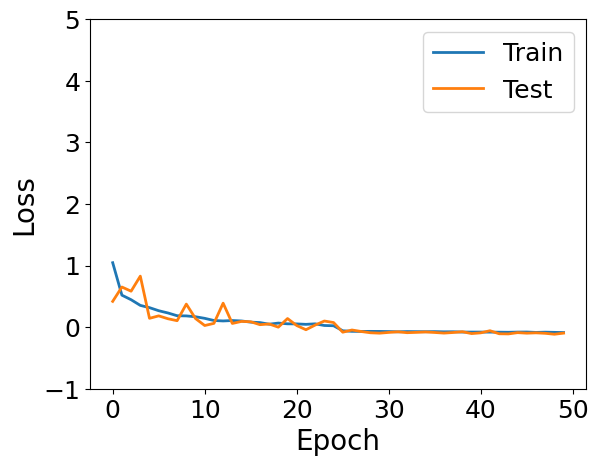

In [7]:
import matplotlib.pyplot as plt

plt.plot(train_loss, linewidth=2)
plt.plot(test_loss, linewidth=2)
plt.xlabel('Epoch', fontsize=20)
plt.ylabel('Loss', fontsize=20)
plt.tick_params(labelsize=18)
plt.ylim([-1,5])
plt.legend(["Train","Test"], fontsize=18)

# plt.savefig('figs/tf_loss_curve.png', dpi=200, bbox_inches='tight', pad_inches=0)

In [8]:
def rolling_average_1d(data: list, window_size: int) -> list:
    """
    Compute the rolling average of a 1D Python list.
    
    Args:
        data (list): Input 1D list of numerical values.
        window_size (int): The size of the moving window for the rolling average.

    Returns:
        list: The rolling average as a list.
    """
    if not isinstance(data, list):
        raise ValueError("Input must be a list.")
    if window_size < 1:
        raise ValueError("Window size must be at least 1.")
    if len(data) < window_size:
        raise ValueError("Window size must be smaller than or equal to the length of the list.")

    # Compute the rolling average
    rolling_avg = [
        sum(data[i:i + window_size]) / window_size
        for i in range(len(data) - window_size + 1)
    ]
    
    return rolling_avg

(0.0, 1.0)

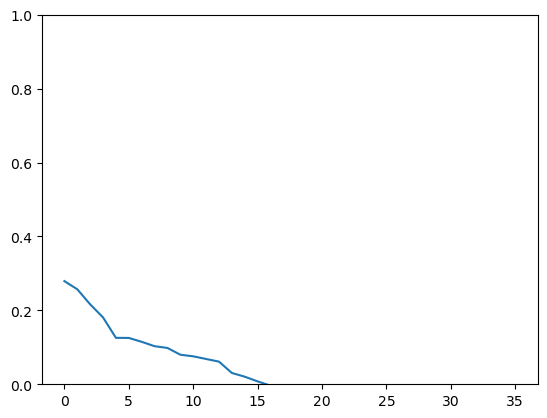

In [9]:
vec = rolling_average_1d(test_loss, window_size = 15)
plt.plot(vec)
plt.ylim([0,1])

In [ ]:
train_loss = torch.load('models/train_loss_1120_2.pt')
print(train_loss[-1])
test_loss = torch.load('models/test_loss_1120_2.pt')
print(test_loss[-1])

In [ ]:
plt.plot(train_loss)
plt.plot(test_loss)

# Validation

In [10]:
device = 'cuda'

### Landslide

tensor([-3.4028e+38,  0.0000e+00,  1.0000e+00])
tensor([-1.,  0.,  1.])
torch.Size([1, 1669, 3440])
torch.Size([192, 192])
tensor([0., 1.])


(-0.5, 191.5, 191.5, -0.5)

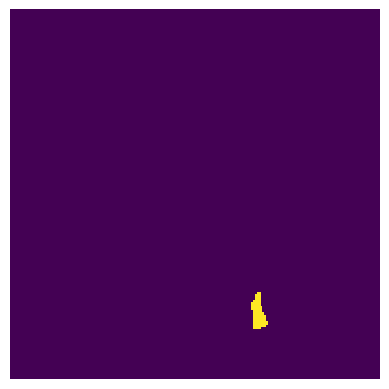

In [11]:
from PIL import Image
from torchvision.transforms import ToTensor

# load mask

target = Image.open('ValidationData/PNG_Landslide_Mask.tif')
target = ToTensor()(target)

print(torch.unique(target))
target[target<-1] = -1
print(torch.unique(target))

print(target.shape)

target_landslide = target[0,1248:1440,448:640] # smaller scene with landslide
print(target_landslide.shape)
print(torch.unique(target_landslide))

plt.imshow(target_landslide, interpolation='None')
plt.axis('off')

In [12]:
landslide = torch.load('ValidationData/landslide_chip.pt')
print(landslide.shape)
landslide = landslide[9:20,:,:,:] # get 10 pre images + 1 post event image
print(landslide.shape)
landslide_logit = torch.special.logit(landslide).float()

pre_landslide = landslide_logit[:-1, :, : , :].unsqueeze(dim=0)
post_landslide = landslide_logit[-1, :, : , :].unsqueeze(dim=0)

print(pre_landslide.shape)
print(post_landslide.shape)

pre_landslide = pre_landslide.to(device)

torch.Size([24, 2, 192, 192])
torch.Size([11, 2, 192, 192])
torch.Size([1, 10, 2, 192, 192])
torch.Size([1, 2, 192, 192])


([], [])

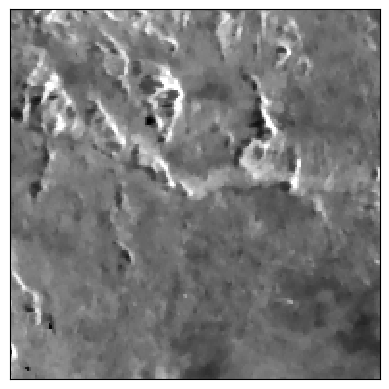

In [13]:
plt.imshow(landslide[-2, 0, ...], interpolation='None', cmap='gray', vmax=.4)
plt.xticks([])
plt.yticks([])
# plt.savefig("figs/pre_landslide_diagram_4.png", dpi=200, bbox_inches='tight', pad_inches=0)

### Chile Fire

In [ ]:
# row_min = 1700
# row_max = row_min+224*5
# col_min = 800
# col_max = col_min+224*5

row_min = 1500
row_max = row_min+224*7
col_min = 1000
col_max = col_min+224*5

In [ ]:
target_fire = torch.load('ValidationData/fire_mask.pt',weights_only=True)
# target_mask = target_mask[1504:,1000:]
target_fire = target_fire[row_min:row_max,col_min:col_max]
print(target_fire.shape)
plt.imshow(target_fire, interpolation='none')
plt.axis('off')

In [ ]:
fire_data = torch.load('ValidationData/fire_val_data.pt', weights_only=True)
print(fire_data.shape)
fire_data = fire_data[:,:,row_min:row_max,col_min:col_max]
print(fire_data.shape)
plt.imshow(fire_data[-1,1,...], interpolation='none',vmax=.1)
plt.colorbar()

In [ ]:
fire_data_logit = torch.special.logit(fire_data).float()
print(fire_data_logit.dtype)

plt.imshow(fire_data_logit[-1,1,...], interpolation='none')
plt.colorbar()

In [ ]:
device = 'cuda'
pre_fire = fire_data_logit[:7, :, : , :].unsqueeze(dim=0).to(device) # we have 7 pre fire images
post_fire = fire_data_logit[-1, :, : , :].unsqueeze(dim=0)

print(pre_fire.shape)
print(post_fire.shape)

In [ ]:
from IPython.display import HTML

ani = animate_data(pre_fire[0,...].cpu(), post_fire[0,...], interval=500, vmax=.15)

HTML(ani.to_jshtml())

### Flood

In [ ]:
target_bangladesh = torch.load('ValidationData/bangladesh_map.pt')
print(target_bangladesh.shape)
target_bangladesh = target_bangladesh[1248:,1248:]
print(target_bangladesh.shape)
plt.imshow(target_bangladesh, interpolation='none')
# plt.colorbar()
plt.axis('off')

In [ ]:
bangladesh_data = torch.load('ValidationData/bangladesh_val_data.pt')
bangladesh_data = bangladesh_data[:,:,1248:,1248:]
print(bangladesh_data.shape)

In [ ]:
bangladesh_logit = torch.special.logit(bangladesh_data).float()
print(bangladesh_logit.dtype)

pre_bangladesh = bangladesh_logit[:4, :, : , :].unsqueeze(dim=0).to(device) # we only have 4 images before flooding began
post_bangladesh = bangladesh_logit[-1, :, : , :].unsqueeze(dim=0) # july 5

print(pre_bangladesh.shape)
print(post_bangladesh.shape)

## Inference

### Non-autoregressive

In [23]:
def make_preds_sliding(model, pre_imgs, chip_size=8, stride=1, flatten = True):
  '''
  pre_imgs: (Batch, Time, Channels, Height, Width) (Batch == 1)
  '''

  assert stride <= chip_size
  assert stride > 0

  data_dim_row = pre_imgs.shape[-2]
  data_dim_col = pre_imgs.shape[-1]

  assert data_dim_row % chip_size == 0
  assert data_dim_col % chip_size == 0

  pred_means = torch.zeros((1,2,data_dim_row,data_dim_col), device=pre_imgs.device)
  pred_logvars = torch.zeros_like(pred_means)
  div_mat = torch.zeros_like(pred_means)

  index_range_row = int(data_dim_row - chip_size + 1)
  index_range_col = int(data_dim_col - chip_size + 1)

  model.eval() # account for dropout, etc
  with torch.no_grad(): # tells torch it doesn't need to keep track of gradients

    for i in tqdm(range(0,index_range_row,stride)):
      for j in range(0,index_range_col,stride):

        if flatten:
          chip_mean, chip_logvar = model(pre_imgs[:,:,:,i:(i+chip_size),j:(j+chip_size)].flatten(start_dim=2))
        else:
          chip_mean, chip_logvar = model(pre_imgs[:,:,:,i:(i+chip_size),j:(j+chip_size)])

        pred_means[:,:,i:(i+chip_size),j:(j+chip_size)] += chip_mean.reshape((1,2,chip_size,chip_size))
        pred_logvars[:,:,i:(i+chip_size),j:(j+chip_size)] += chip_logvar.reshape((1,2,chip_size,chip_size))
        div_mat[:,:,i:(i+chip_size),j:(j+chip_size)] += 1 #count how many times we hit a certain pixel

  pred_means = pred_means / div_mat
  pred_logvars = pred_logvars / div_mat

  return pred_means, pred_logvars

### Autoregressive

In [16]:
def make_preds_sliding(model, pre_imgs, chip_size=8, stride=1, flatten = True):
  '''
  pre_imgs: (Batch, Time, Channels, Height, Width) (Batch == 1)
  '''

  assert stride <= chip_size
  assert stride > 0

  data_dim_row = pre_imgs.shape[-2]
  data_dim_col = pre_imgs.shape[-1]

  assert data_dim_row % chip_size == 0
  assert data_dim_col % chip_size == 0

  pred_means = torch.zeros((1,2,data_dim_row,data_dim_col), device=pre_imgs.device)
  pred_logvars = torch.zeros_like(pred_means)
  div_mat = torch.zeros_like(pred_means)

  index_range_row = int(data_dim_row - chip_size + 1)
  index_range_col = int(data_dim_col - chip_size + 1)

  model.eval() # account for dropout, etc
  with torch.no_grad(): # tells torch it doesn't need to keep track of gradients

    for i in tqdm(range(0,index_range_row,stride)):
      for j in range(0,index_range_col,stride):

        if flatten:
          chip_mean, chip_logvar = model(pre_imgs[:,:,:,i:(i+chip_size),j:(j+chip_size)].flatten(start_dim=2))
        else:
          chip_mean, chip_logvar = model(pre_imgs[:,:,:,i:(i+chip_size),j:(j+chip_size)])

          # get just the last one, since the model outputs predictions at each timesteps
          chip_mean = chip_mean[:,-1,...]
          chip_logvar = chip_logvar[:,-1,...]
        print(np.shape(chip_mean))
        pred_means[:,:,i:(i+chip_size),j:(j+chip_size)] += chip_mean.reshape((1,2,chip_size,chip_size))
        pred_logvars[:,:,i:(i+chip_size),j:(j+chip_size)] += chip_logvar.reshape((1,2,chip_size,chip_size))
        div_mat[:,:,i:(i+chip_size),j:(j+chip_size)] += 1 #count how many times we hit a certain pixel

  pred_means = pred_means / div_mat
  pred_logvars = pred_logvars / div_mat

  return pred_means, pred_logvars

### Eval

In [20]:
transformer = SpatioTemporalTransformer(tf_config).to(device)
# transformer.load_state_dict(torch.load(f"models/transformer_10-31-2024 18:20.pth"))
# transformer.load_state_dict(torch.load(f"models/transformer_04-21-2025 23:33.pth"))
# transformer.load_state_dict(torch.load(f"/mnt/aurora-r0/jungkyo/OPERA/DIST-S1/algorithms/dist-s1-model/models/transformer_06-02-2025 17:17.pth"))
transformer.load_state_dict(torch.load(f"/mnt/aurora-r0/jungkyo/OPERA/DIST-S1/algorithms/dist-s1-model/models/transformer_06-07-2025 04:33.pth"))
print("Number of parameters: ", transformer.num_parameters())

# rnn = RNN(rnn_config).to(device)
# rnn.load_state_dict(torch.load(f"models/RNN_11-22-2024 20:23.pth"))
# print("Number of parameters: ", rnn.num_parameters())

#RNN_11-22-2024 20:23
#rnn_11-21-2024 23:54

Number of parameters:  3261952


In [21]:
transformer

SpatioTemporalTransformer(
  (embedding): Linear(in_features=128, out_features=256, bias=True)
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-3): 4 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=256, out_features=256, bias=True)
        )
        (linear1): Linear(in_features=256, out_features=768, bias=True)
        (dropout): Dropout(p=0.2, inplace=False)
        (linear2): Linear(in_features=768, out_features=256, bias=True)
        (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.2, inplace=False)
        (dropout2): Dropout(p=0.2, inplace=False)
      )
    )
  )
  (mean_out): Sequential(
    (0): Linear(in_features=256, out_features=768, bias=True)
    (1): ReLU()
    (2): Linear(in_features=768, out_features=128, bias=True)
  )
  (logvar_out): Se

In [24]:
event = 'New Guinea Landslide'

if event == 'New Guinea Landslide':
  pre_imgs = pre_landslide
  post_img = post_landslide
  target_mask = target_landslide
  stride=1
  name_event = 'landslide' # for saving figs
elif event == 'Chile Fire':
  pre_imgs = pre_fire
  post_img = post_fire
  target_mask = target_fire
  stride=4
  name_event = 'fire'
elif event == 'Bangladesh Flood':
  pre_imgs = pre_bangladesh
  post_img = post_bangladesh
  target_mask = target_bangladesh
  stride=4
  name_event = 'flood'
else:
  raise NotImplementedError

# rnn_means, rnn_logvars = make_preds_sliding(rnn, pre_imgs[:, :-1, ...], chip_size=8, stride=stride)
tf_means, tf_logvars = make_preds_sliding(transformer, pre_imgs[:, :-1, ...], chip_size=16, flatten=False, stride=stride)

100%|██████████| 177/177 [00:37<00:00,  4.77it/s]


In [28]:
def make_preds_sliding(model, pre_imgs, chip_size=16, stride=16, flatten=False):
    batch, T, C, H, W = pre_imgs.shape
    first = True
    model.eval()
    with torch.no_grad():
        for i in range(0, H - chip_size + 1, stride):
            for j in range(0, W - chip_size + 1, stride):

                chip = pre_imgs[:, :, :, i:i+chip_size, j:j+chip_size]
                if flatten:
                    chip = chip.flatten(start_dim=2)

                mu, logvar = model(chip)         # already (1, C, 16, 16)

                if first:
                    out_ch = mu.shape[1]         # 2
                    pred_means   = torch.zeros((1, out_ch, H, W),
                                               device=pre_imgs.device)
                    pred_logvars = torch.zeros_like(pred_means)
                    div_mat      = torch.zeros_like(pred_means)
                    first = False

                pred_means[:, :, i:i+chip_size, j:j+chip_size]   += mu
                pred_logvars[:, :, i:i+chip_size, j:j+chip_size] += logvar
                div_mat[:, :, i:i+chip_size, j:j+chip_size]      += 1

    return pred_means / div_mat, pred_logvars / div_mat

tf_means, tf_logvars = make_preds_sliding(transformer, pre_imgs[:, :-1, ...], chip_size=16, stride=2, flatten=False)

In [26]:
tf_means

tensor([[[[-1.4765, -1.4735, -1.4466,  ..., -1.7846, -1.8052, -1.7628],
          [-1.4385, -1.4313, -1.4001,  ..., -1.8161, -1.8455, -1.7977],
          [-1.3907, -1.4202, -1.3990,  ..., -1.8430, -1.8748, -1.8224],
          ...,
          [-1.1090, -1.1250, -1.1655,  ..., -1.7468, -1.7462, -1.7278],
          [-1.1681, -1.2023, -1.2442,  ..., -1.7444, -1.7325, -1.7203],
          [-1.2141, -1.2391, -1.2782,  ..., -1.7420, -1.7223, -1.7236]],

         [[-3.0636, -3.0717, -3.0431,  ..., -3.3347, -3.3223, -3.2721],
          [-2.9997, -3.0254, -2.9949,  ..., -3.3371, -3.3427, -3.2760],
          [-2.9687, -2.9787, -2.9719,  ..., -3.3327, -3.3389, -3.2782],
          ...,
          [-2.8366, -2.8417, -2.9080,  ..., -3.0952, -3.0559, -3.0393],
          [-2.8683, -2.9094, -2.9787,  ..., -3.0912, -3.0465, -3.0306],
          [-2.8984, -2.9343, -2.9814,  ..., -3.0747, -3.0441, -3.0339]]]],
       device='cuda:0')

FileNotFoundError: [Errno 2] No such file or directory: '/mnt/aurora-r0/jungkyo/OPERA/DIST-S1/algorithms/dist-s1-model/figs/tf_std_diagram.png'

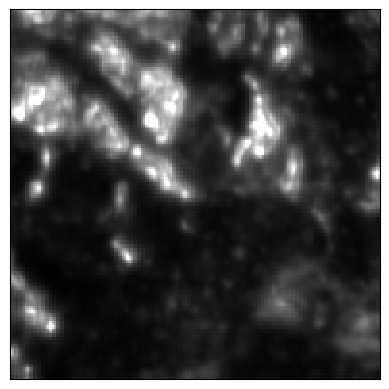

In [29]:
plt.imshow(np.sqrt(np.exp(tf_logvars[0,0,...].detach().cpu().numpy())), interpolation='none', cmap='gray', vmax=.3)
plt.xticks([])
plt.yticks([])
plt.savefig("figs/tf_std_diagram.png", dpi=200, bbox_inches='tight', pad_inches=0)

In [31]:
dam = compute_damage_map(tf_means[0,0,...], tf_logvars[0,0,...], post_landslide[0,0,...])

FileNotFoundError: [Errno 2] No such file or directory: '/mnt/aurora-r0/jungkyo/OPERA/DIST-S1/algorithms/dist-s1-model/figs/dam_map_diagram.png'

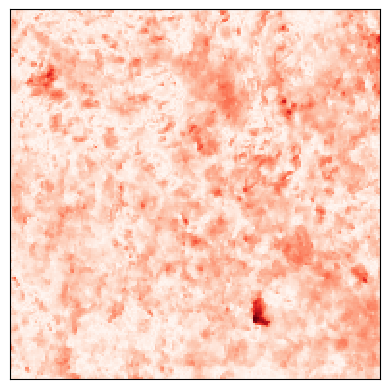

In [32]:
plt.imshow(dam, interpolation='none', cmap='Reds', vmax=8)
plt.xticks([])
plt.yticks([])
plt.savefig("figs/dam_map_diagram.png", dpi=200, bbox_inches='tight', pad_inches=0)

### Viz

tensor(4.8329)
tensor(4.7684e-06)
tensor(0.4034)
tensor(0.1022)
tensor(0.3509)
tensor(0.1075)
tensor(6.2112)


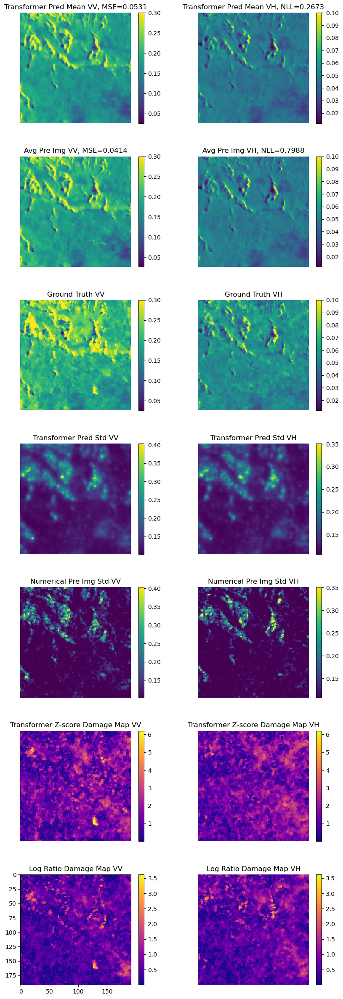

In [33]:
tf_damage_map, log_ratio_im = visualize_reconstruction(pre_imgs[0,...], post_img[0,...], tf_means[0,...], tf_logvars[0,...], 'Transformer', is_logit=True, vmax_vv=.3, vmax_vh=.1)

In [ ]:
# non damaged scene:
tf_damage_map, log_ratio_im = visualize_reconstruction(pre_imgs[0, :-1, ...], pre_imgs[0, -1, ...], tf_means[0,...], tf_logvars[0,...], 'Transformer', is_logit=True, vmax_vv=.3, vmax_vh=.1)

### Helpers

In [30]:
from sklearn.metrics import precision_recall_curve, roc_curve, roc_auc_score, auc, average_precision_score

def compute_roc(pred_map, target_map):
  '''
  Computes num_maps of binary damage maps based on input
  pred_map (ie log ratio, z-score, etc)
  '''
  assert pred_map.shape == target_map.shape

  target_map = target_map.flatten().cpu().numpy()
  pred_map = pred_map.flatten().cpu().numpy()

  precisions, recalls, thresholds = precision_recall_curve(target_map, pred_map)
  fprs, tprs, _ = roc_curve(target_map, pred_map)

  f1_scores = 2*recalls*precisions/(recalls+precisions)
  f1_scores[np.isnan(f1_scores)] = 0

  roc_auc = roc_auc_score(target_map, pred_map)

  pr_auc = average_precision_score(target_map, pred_map)

  # put metrics into a dictionary

  metrics = {'precisions': precisions,
             'recalls': recalls,
             'fprs': fprs,
             'tprs': tprs,
             'f1_scores': f1_scores,
             'thresholds': thresholds,
             'roc_auc': roc_auc,
             'pr_auc' : pr_auc}

  return metrics

def synthesize_damage_map(damage_map, num_scenes=2, method='max'):
  assert damage_map.shape[num_scenes-1] == 2
  assert num_scenes == 1 or num_scenes==2

  if method not in ['max','sum']:
    raise NotImplementedError('Method must be either max or sum')

  if method == 'max':
    return torch.max(damage_map, dim=num_scenes-1)[0]
  elif method == 'sum':
    # this is mahalanobis distance where we assume correlation (off diagonal terms) are close to 0
    if num_scenes==2:
      return torch.sqrt(damage_map[:, 0, ...]**2 + damage_map[:, 1, ...]**2)
    else:
      return torch.sqrt(damage_map[0, ...]**2 + damage_map[1, ...]**2)

def compute_damage_map(pred_mean, pred_logvar, post_img):
  assert pred_mean.shape == pred_logvar.shape
  assert pred_mean.shape == post_img.shape

  post_img = post_img.cpu()
  pred_mean = pred_mean.cpu()
  pred_logvar = pred_logvar.cpu()

  pred_std_image = torch.sqrt(torch.exp(pred_logvar))
  damage_map = torch.absolute((post_img - pred_mean) / pred_std_image)

  return damage_map

### PR Curves etc

In [ ]:
# experiment with non damaged scene + damage scene, per Charlie rec

tf_damage_map1 = compute_damage_map(tf_means[0,...], tf_logvars[0,...], pre_imgs[0, -1, ...]) # no damage
tf_damage_map2 = compute_damage_map(tf_means[0,...], tf_logvars[0,...], post_img[0, ...]) #damage

rnn_damage_map1 = compute_damage_map(rnn_means[0,...], rnn_logvars[0,...], pre_imgs[0, -1, ...])
rnn_damage_map2 = compute_damage_map(rnn_means[0,...], rnn_logvars[0,...], post_img[0, ...])

log_ratio_im1 = log_ratio(pre_imgs[0, :-1, ...].cpu(), pre_imgs[0, -1, ...].cpu(), is_logit=True, method='mean')
log_ratio_im2 = log_ratio(pre_imgs[0, :-1, ...].cpu(), post_img[0,...], is_logit=True, method='mean')

log_ratio_median1 = log_ratio(pre_imgs[0, :-1, ...].cpu(), pre_imgs[0, -1, ...].cpu(), is_logit=True, method='median')
log_ratio_median2 = log_ratio(pre_imgs[0,...].cpu(), post_img[0,...], is_logit=True, method='median')

tf_damage_map = torch.stack((tf_damage_map1, tf_damage_map2))
rnn_damage_map = torch.stack((rnn_damage_map1, rnn_damage_map2))
log_ratio_im = torch.stack((log_ratio_im1, log_ratio_im2))
log_ratio_median = torch.stack((log_ratio_median1, log_ratio_median2))

In [ ]:
max_tf_map = torch.load(f"results/{name_event}_tf_damage_maps.pt", weights_only=True)
max_rnn_map = torch.load(f"results/{name_event}_rnn_damage_maps.pt", weights_only=True)
max_med_map = torch.load(f"results/{name_event}_med_damage_maps.pt", weights_only=True)

In [ ]:
# method = 'max' # can be max or sum

# max_tf_map = synthesize_damage_map(tf_damage_map, method=method)
# max_rnn_map = synthesize_damage_map(rnn_damage_map, method=method)
# max_mean_map = synthesize_damage_map(log_ratio_im, method='max')
# max_med_map = synthesize_damage_map(log_ratio_median, method='max')

two_scene_target = torch.stack((torch.zeros_like(target_mask),target_mask))

model_metrics = compute_roc(max_tf_map, two_scene_target)
rnn_metrics = compute_roc(max_rnn_map, two_scene_target)
# mean_metrics = compute_roc(max_mean_map, two_scene_target)
med_metrics = compute_roc(max_med_map, two_scene_target)

baseline_pr = torch.sum(two_scene_target)/(two_scene_target.shape[0]*two_scene_target.shape[1]*two_scene_target.shape[2])
print(baseline_pr)

In [ ]:
# torch.save(max_tf_map, f"results/{name_event}_tf_damage_maps.pt")
# torch.save(max_rnn_map, f"results/{name_event}_rnn_damage_maps.pt")
# torch.save(max_mean_map, f"results/{name_event}_mean_damage_maps.pt")
# torch.save(max_med_map, f"results/{name_event}_med_damage_maps.pt")

In [ ]:
# def plot_best_map(model_metrics, damage_map):

#   best_threshold = model_metrics['thresholds'][np.argmax(model_metrics['f1_scores'])]
#   best_damage_map = damage_map.cpu() > best_threshold

#   return best_damage_map

# tf_best_damage_map = plot_best_map(model_metrics, max_tf_map)
# rnn_best_damage_map = plot_best_map(rnn_metrics, max_rnn_map)
# mean_best_damage_map = plot_best_map(mean_metrics, max_mean_map)
# med_best_damage_map = plot_best_map(med_metrics, max_med_map)

In [ ]:
# torch.save(tf_best_damage_map, f"results/{name_event}_tf_best.pt")
# torch.save(rnn_best_damage_map, f"results/{name_event}_rnn_best.pt")
# torch.save(mean_best_damage_map, f"results/{name_event}_mean_best.pt")
# torch.save(med_best_damage_map, f"results/{name_event}_med_best.pt")

In [ ]:
print("TF AUC: ", model_metrics['pr_auc'])
print("TF F1: ", np.max(model_metrics['f1_scores']))

print("RNN AUC: ", rnn_metrics['pr_auc'])
print("RNN F1: ", np.max(rnn_metrics['f1_scores']))

# print(mean_metrics['pr_auc'])
# print(np.max(mean_metrics['f1_scores']))

print(med_metrics['pr_auc'])
print(np.max(med_metrics['f1_scores']))

In [ ]:
plt.figure(figsize=(8,6))

plt.plot(model_metrics['recalls'],model_metrics['precisions'],'b')
plt.plot(rnn_metrics['recalls'][:-1],rnn_metrics['precisions'][:-1],'r')
# plt.plot(mean_metrics['recalls'][:-1],mean_metrics['precisions'][:-1],'r')
plt.plot(med_metrics['recalls'][:-1],med_metrics['precisions'][:-1],'g')
plt.plot(np.arange(0,1,.01),torch.ones(100)*baseline_pr,linestyle='dashed',color='tab:grey')
plt.scatter(1,1,c='k',s=50)

plt.plot(model_metrics['recalls'][np.argmax(model_metrics['f1_scores'])],model_metrics['precisions'][np.argmax(model_metrics['f1_scores'])],'b*',markersize=15)
plt.annotate('F1 = {:.3f}'.format(np.max(model_metrics['f1_scores'])),
 (model_metrics['recalls'][np.argmax(model_metrics['f1_scores'])]+.02,model_metrics['precisions'][np.argmax(model_metrics['f1_scores'])]-.02), 
             fontsize=14
 )

plt.plot(rnn_metrics['recalls'][np.argmax(rnn_metrics['f1_scores'])],rnn_metrics['precisions'][np.argmax(rnn_metrics['f1_scores'])],'r*',markersize=15)
plt.annotate('F1 = {:.3f}'.format(np.max(rnn_metrics['f1_scores'])),
(rnn_metrics['recalls'][np.argmax(rnn_metrics['f1_scores'])]-.2,rnn_metrics['precisions'][np.argmax(rnn_metrics['f1_scores'])]-.04),
             fontsize=14
)

# plt.plot(mean_metrics['recalls'][np.argmax(mean_metrics['f1_scores'])],mean_metrics['precisions'][np.argmax(mean_metrics['f1_scores'])],'r*',markersize=15)
# plt.annotate('F1 = {:.3f}'.format(np.max(mean_metrics['f1_scores'])),
#  (mean_metrics['recalls'][np.argmax(mean_metrics['f1_scores'])]+.02,mean_metrics['precisions'][np.argmax(mean_metrics['f1_scores'])]-.01),
#              fontsize=14
#  )

plt.plot(med_metrics['recalls'][np.argmax(med_metrics['f1_scores'])],med_metrics['precisions'][np.argmax(med_metrics['f1_scores'])],'g*',markersize=15)
plt.annotate('F1 = {:.3f}'.format(np.max(med_metrics['f1_scores'])),
 (med_metrics['recalls'][np.argmax(med_metrics['f1_scores'])]-.2,med_metrics['precisions'][np.argmax(med_metrics['f1_scores'])]-.02),
             fontsize=14
 )

plt.annotate("Random Classifier",(0.55,baseline_pr+.02), c='tab:grey', fontsize=14)
plt.annotate("Perfect",(.86,.97),fontsize=14)
plt.annotate("Classifier",(.86,.92),fontsize=14)

plt.legend(['Transformer AUC={:.3f}'.format(model_metrics['pr_auc']),
            'RNN AUC={:.3f}'.format(rnn_metrics['pr_auc']),
            'Log Ratio AUC={:.3f}'.format(med_metrics['pr_auc']), #'Log Ratio (Mean) AUC={:.3f}'.format(mean_metrics['pr_auc']),
  ], fontsize=14,loc='lower left', bbox_to_anchor=(0, 0.05))
plt.xlabel("Recall", fontsize=16)
plt.ylabel("Precision",fontsize=16)

plt.tick_params(axis='both', which='major', labelsize=14) 
plt.ylim(bottom=0, top=1.01)
plt.xlim(left=0, right=1.01)

# channel_name = 'VV' if channel==0 else 'VH'
# channel_name = 'Both'
# plt.title(f"Precision-Recall Curve for {event}") #, Method={method}")

plt.savefig(f"figs/{name_event}_PR.png", dpi=200, bbox_inches='tight', pad_inches=0)

In [ ]:
fig, ax = plt.subplots()

fig.set_figheight(4.8)
fig.set_figwidth(6.4)

ax.plot(100*model_metrics['thresholds']/model_metrics['thresholds'][-1],model_metrics['f1_scores'][:-1],'b')
ax.plot(100*rnn_metrics['thresholds']/rnn_metrics['thresholds'][-1],rnn_metrics['f1_scores'][:-1],'r')
# ax.plot(100*mean_metrics['thresholds']/mean_metrics['thresholds'][-1],mean_metrics['f1_scores'][:-1],'r')
ax.plot(100*med_metrics['thresholds']/med_metrics['thresholds'][-1],med_metrics['f1_scores'][:-1],'g')

ax.set_xlabel('Threshold (%)', fontsize=16)
ax.set_ylabel('F1 Score',fontsize=16)
ax.set_ylim(0,model_metrics['f1_scores'][np.argmax(model_metrics['f1_scores'])]+.05)
ax.set_xlim(0,100)
ax.tick_params(axis='both', which='major', labelsize=14) 

ax.plot(100*model_metrics['thresholds'][np.argmax(model_metrics['f1_scores'])]/model_metrics['thresholds'][-1],
           model_metrics['f1_scores'][np.argmax(model_metrics['f1_scores'])],'b*',markersize=15)
ax.annotate('F1 = {:.3f}'.format(np.max(model_metrics['f1_scores'])),
 (100*model_metrics['thresholds'][np.argmax(model_metrics['f1_scores'])]/model_metrics['thresholds'][-1] + 2,
  model_metrics['f1_scores'][np.argmax(model_metrics['f1_scores'])]), fontsize = 14
 ) 

ax.plot(100*rnn_metrics['thresholds'][np.argmax(rnn_metrics['f1_scores'])]/rnn_metrics['thresholds'][-1],
           rnn_metrics['f1_scores'][np.argmax(rnn_metrics['f1_scores'])],'r*',markersize=15)
ax.annotate('F1 = {:.3f}'.format(np.max(rnn_metrics['f1_scores'])),
 (100*rnn_metrics['thresholds'][np.argmax(rnn_metrics['f1_scores'])]/rnn_metrics['thresholds'][-1] + 2,
  rnn_metrics['f1_scores'][np.argmax(rnn_metrics['f1_scores'])]), fontsize = 14
 )

# ax.plot(100*mean_metrics['thresholds'][np.argmax(mean_metrics['f1_scores'])]/mean_metrics['thresholds'][-1],
#            mean_metrics['f1_scores'][np.argmax(mean_metrics['f1_scores'])],'r*',markersize=15)
# ax.annotate('F1 = {:.3f}'.format(np.max(mean_metrics['f1_scores'])),
#  (100*mean_metrics['thresholds'][np.argmax(mean_metrics['f1_scores'])]/mean_metrics['thresholds'][-1] + 2,
#   mean_metrics['f1_scores'][np.argmax(mean_metrics['f1_scores'])]), fontsize = 14
#  )

ax.plot(100*med_metrics['thresholds'][np.argmax(med_metrics['f1_scores'])]/med_metrics['thresholds'][-1],
           med_metrics['f1_scores'][np.argmax(med_metrics['f1_scores'])],'g*',markersize=15)
ax.annotate('F1 = {:.3f}'.format(np.max(med_metrics['f1_scores'])),
 (100*med_metrics['thresholds'][np.argmax(med_metrics['f1_scores'])]/med_metrics['thresholds'][-1] + 2,
  med_metrics['f1_scores'][np.argmax(med_metrics['f1_scores'])]), fontsize = 14
 )

plt.legend(['Transformer',
            'RNN',
            'Log Ratio',
  ], fontsize=14,loc='upper right')

plt.savefig(f"figs/{name_event}_threshold.png", dpi=200, bbox_inches='tight', pad_inches=0.1)

### TF Threshold comparison

In [ ]:
landslide_map = torch.load(f"results/landslide_tf_damage_maps.pt", weights_only=True)
fire_map = torch.load(f"results/fire_tf_damage_maps.pt", weights_only=True)
flood_map = torch.load(f"results/flood_tf_damage_maps.pt", weights_only=True)

In [ ]:
two_scene_target_landslide = torch.stack((torch.zeros_like(target_landslide),target_landslide))
two_scene_target_fire = torch.stack((torch.zeros_like(target_fire),target_fire))
two_scene_target_flood = torch.stack((torch.zeros_like(target_bangladesh),target_bangladesh))

landslide_metrics = compute_roc(landslide_map, two_scene_target_landslide)
fire_metrics = compute_roc(fire_map, two_scene_target_fire)
flood_metrics = compute_roc(flood_map, two_scene_target_flood)

In [ ]:
model_metrics = landslide_metrics
rnn_metrics = fire_metrics
med_metrics = flood_metrics

fig, ax = plt.subplots()

fig.set_figheight(4.8)
fig.set_figwidth(6.4)

ax.plot(model_metrics['thresholds'],model_metrics['f1_scores'][:-1],'b')
ax.plot(rnn_metrics['thresholds'],rnn_metrics['f1_scores'][:-1],'r')
ax.plot(med_metrics['thresholds'],med_metrics['f1_scores'][:-1],'g')

ax.set_xlabel('Threshold (SD)', fontsize=16)
ax.set_ylabel('F1 Score',fontsize=16)
ax.set_ylim(0,model_metrics['f1_scores'][np.argmax(model_metrics['f1_scores'])]+.05)
ax.set_xlim(0,25)
ax.tick_params(axis='both', which='major', labelsize=14) 

ax.plot(model_metrics['thresholds'][np.argmax(model_metrics['f1_scores'])],
           model_metrics['f1_scores'][np.argmax(model_metrics['f1_scores'])],'b*',markersize=15)
ax.annotate('F1 = {:.3f}'.format(np.max(model_metrics['f1_scores'])),
 (model_metrics['thresholds'][np.argmax(model_metrics['f1_scores'])] + .5,
  model_metrics['f1_scores'][np.argmax(model_metrics['f1_scores'])]), fontsize = 14
 ) 

ax.plot(rnn_metrics['thresholds'][np.argmax(rnn_metrics['f1_scores'])],
           rnn_metrics['f1_scores'][np.argmax(rnn_metrics['f1_scores'])],'r*',markersize=15)
ax.annotate('F1 = {:.3f}'.format(np.max(rnn_metrics['f1_scores'])),
 (rnn_metrics['thresholds'][np.argmax(rnn_metrics['f1_scores'])] - 3.3,
  rnn_metrics['f1_scores'][np.argmax(rnn_metrics['f1_scores'])] + .02), fontsize = 14
 )

ax.plot(med_metrics['thresholds'][np.argmax(med_metrics['f1_scores'])],
           med_metrics['f1_scores'][np.argmax(med_metrics['f1_scores'])],'g*',markersize=15)
ax.annotate('F1 = {:.3f}'.format(np.max(med_metrics['f1_scores'])),
 (med_metrics['thresholds'][np.argmax(med_metrics['f1_scores'])] + .5,
  med_metrics['f1_scores'][np.argmax(med_metrics['f1_scores'])]), fontsize = 14
 )

plt.legend(['Landslide',
            'Fire',
            'Flood',
  ], fontsize=14,loc='upper right')

plt.savefig(f"figs/tf_all_threshold.png", dpi=200, bbox_inches='tight', pad_inches=0.1)

# Plotting with Contextily and Rasterio

In [ ]:
import rasterio

with rasterio.open('ValidationData/copernicus_fire_map.tif') as ds:
    X0 = ds.read(1)

In [ ]:
plt.imshow(X0, interpolation='none')

In [ ]:
plt.imshow(max_tf_map[-1,...], cmap='plasma')
plt.colorbar()

In [ ]:
# image = max_tf_map[-1,...]
image = X0
# bounds = [88.96546265, 21.65505773, 91.33990759, 24.17825791] #bangladesh flood
# bounds = [88.965442, 21.654429, 91.198689, 24.178055]
# bounds = [88.96546265-.5, 21.65505773, 91.33990759-.5, 24.17825791]

# bounds = [-71.53071089, -33.20143816, -71.2964628 , -32.98270579] #chile fire

# bounds = [143.3,  -5.4, 143.4,  -5.3] #new guinea landslide

# code here to account for how I chopped up the image, see notebook

# Unpack the bounds
min_lon, min_lat, max_lon, max_lat = bounds

# Plot the image with the extent defined by the bounds
plt.imshow(image, extent=[min_lon, max_lon, min_lat, max_lat], cmap='plasma', origin='upper')
plt.colorbar(label='Likelihood of Damage')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Damage Likelihood with Geospatial Bounds')
plt.show()

In [ ]:
# Transform bounds from EPSG:4326 to EPSG:3857
transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)
min_lon_wm, min_lat_wm = transformer.transform(min_lon, min_lat)
max_lon_wm, max_lat_wm = transformer.transform(max_lon, max_lat)

# Update the extent for the basemap
extent_wm = [min_lon_wm, max_lon_wm, min_lat_wm, max_lat_wm]

In [ ]:
import contextily as ctx
from matplotlib_scalebar.scalebar import ScaleBar
from pyproj import Geod

fig, ax = plt.subplots(figsize=(7, 7))
ax.imshow(image, extent=[min_lon, max_lon, min_lat, max_lat], cmap='plasma', alpha=1, origin='upper')

# Add the basemap
ctx.add_basemap(ax, crs="EPSG:4326", source=ctx.providers.Esri.WorldImagery, alpha=.5)

# have to do this so scalebar is correct
center_lat = (bounds[1] + bounds[3]) / 2
center_lon = (bounds[0] + bounds[2]) / 2
geod = Geod(ellps="WGS84")
distance_meters, _, _ = geod.inv(center_lon, center_lat, center_lon + 1, center_lat)
scale_factor = distance_meters

scalebar = ScaleBar(scale_factor, units="km", location="lower right", scale_loc="bottom", length_fraction=0.1)
ax.add_artist(scalebar)

# Add labels and title
# plt.colorbar(ax.images[0], ax=ax, label='Likelihood of Damage')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('Damage Likelihood Overlayed on ESRI')
plt.tight_layout()
plt.show()

In [ ]:
import contextily as ctx

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(image, extent=extent_wm, cmap='plasma', alpha=0.9, origin='upper')

# Add the basemap
ctx.add_basemap(ax, crs="EPSG:3857", source=ctx.providers.Esri.WorldImagery, alpha=.5)

# Add labels and title
plt.colorbar(ax.images[0], ax=ax, label='Likelihood of Damage')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('Damage Likelihood Overlayed on Basemap')
plt.show()